# Load libraries

In [307]:
import sys
import numpy as np
import pandas as pd
import scanpy as sc
import anndata as ad
import scipy.io as io
from scipy.sparse import csr_matrix
import logging
import os
import matplotlib.pyplot as plt
import seaborn as sns
import csv
import scipy.stats as stats
import statsmodels.formula.api as smf
import statsmodels.api as sm
import math
import gc
from sklearn.feature_selection import RFE
from sklearn.feature_selection import SelectFromModel
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from imblearn.over_sampling import SMOTE
import random
from sklearn.utils import shuffle
import combat
import patsy
import warnings
warnings.simplefilter('ignore')
logging.basicConfig(level=logging.INFO)
savepath = 'Lupus_study_adjusted_V3.h5ad'
nonormpath = 'Lupus_study_nonorm.h5ad'

# Read data

In [9]:
%matplotlib inline
sc.settings.verbosity = 2
sc.settings.autoshow = False
sc.settings.set_figure_params(dpi=100, dpi_save=300, format='png', frameon=False, transparent=True, fontsize=16)
plt.rcParams["image.aspect"] = "equal"
adata = sc.read(savepath, cache=True)
print('Processed dataset: {}'.format(adata))
figdir = "./figures."
sc.settings.figdir = "./figures."
MASTERCOLORS = sc.pl.palettes.default_64
MASTERCOLORS.remove("#FEFFE6")
MASTERCOLORS.remove("#FFFF00")


Processed dataset: AnnData object with n_obs × n_vars = 912434 × 1000 
    obs: 'Broad', 'CD127|IL7R|j95-27|pAbO', 'CD14|CD14|j95-20|pAbO', 'CD161|KLRB1|j95-11|pAbO', 'CD183|CXCR3|j95-12|pAbO', 'CD185|CXCR5|j95-22|pAbO', 'CD194|CCR4|j95-21|pAbO', 'CD196|CCR6|j95-17|pAbO', 'CD197|CCR7|j95-09|pAbO', 'CD19|CD19|j95-10|pAbO', 'CD25|IL2RA|j95-24|pAbO', 'CD27|CD27|j95-08|pAbO', 'CD28|CD28|j95-07|pAbO', 'CD38|CD38|j95-01|pAbO', 'CD3|CD3E|j95-16|pAbO', 'CD45RA|PTPRC|j95-28|pAbO', 'CD45RO|PTPRC|j95-19|pAbO', 'CD4|CD4|j95-14|pAbO', 'CD8|CD8A|j95-25|pAbO', 'CD95|FAS|j95-02|pAbO', 'Female', 'HLA-DR|CD74|j95-18|pAbO', 'Prob(doublet)', 'SOURCE', 'batch', 'batch_cov', 'ct_cov', 'disease_cov', 'ind_cov', 'pop_cov', 'well', 'percent_mito', 'n_counts', 'n_genes', 'PF4', 'TTTY15', 'HBA2', 'PC2', 'PC3', 'PC10', 'PC15', 'PC16', 'PC39', 'leiden', 'site', 'disease_pop_site_cov', 'ind_cov_disease_cov', 'SLE status'
    var: 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dif

ValueError: list.remove(x): x not in list

In [23]:
adata.obs['ind_cov'][adata.obs['ind_cov']=='1771'] = '1771_1771'
adata.obs['ind_cov'][adata.obs['ind_cov']=='1791'] = '1791_1791'
adata.obs['ind_cov'][adata.obs['ind_cov']=='1240'] = '904425200_904425200'
adata.obs['ind_cov'][adata.obs['ind_cov']=='FLARE003'] = '904194200_904194200'
adata.obs['ind_cov'][adata.obs['ind_cov']=='FLARE008'] = '1763_1763'

# Projections

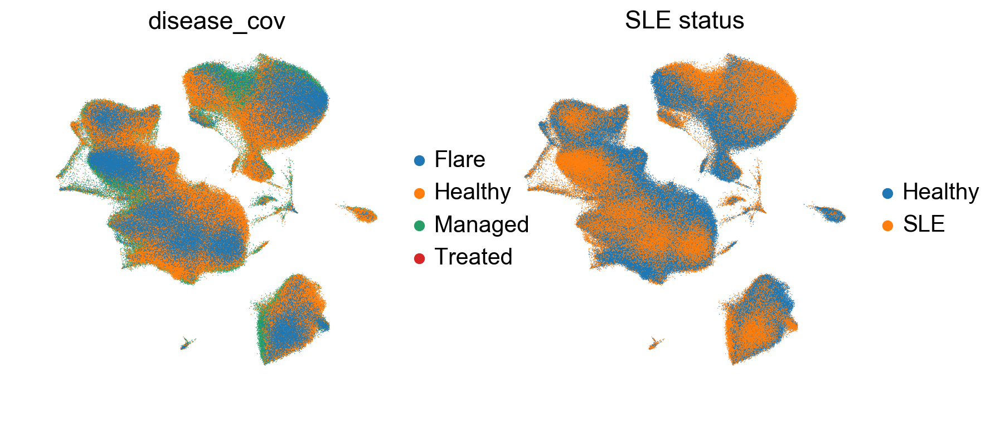

In [4]:
disease_umap = sc.pl.umap(adata, color=['disease_cov', 'SLE status'], size=1, show=True, edgecolor="none", palette=sc.pl.palettes.vega_20_scanpy, save='.disease.png')

In [ ]:
sc.tl.embedding_density(adata, basis='umap', groupby='disease_cov')
sc.pl.embedding_density(adata, basis='umap', key='umap_density_disease_cov', show=True,  save='umap_density_disease_cov.png')

In [ ]:
sc.tl.embedding_density(adata, basis='umap', groupby='disease_cov')
sc.pl.embedding_density(adata, basis='umap', key='umap_density_disease_cov', show=True,  save='umap_density_disease_cov.png')

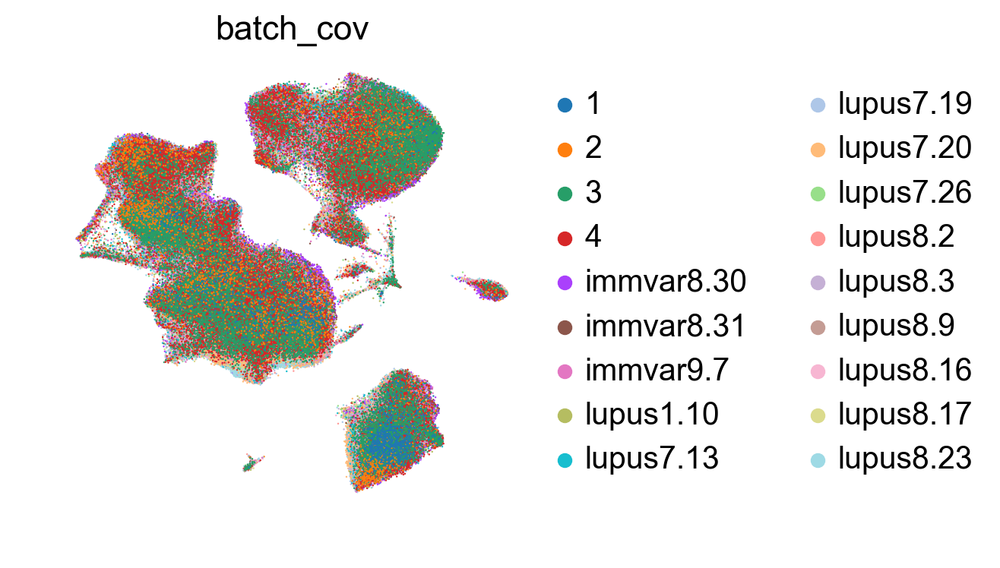

In [5]:
disease_umap = sc.pl.umap(adata, color='batch_cov', size=3,show=True, edgecolor="none", palette=sc.pl.palettes.vega_20_scanpy, save='.batch.png')

# Plot individual variability

Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.


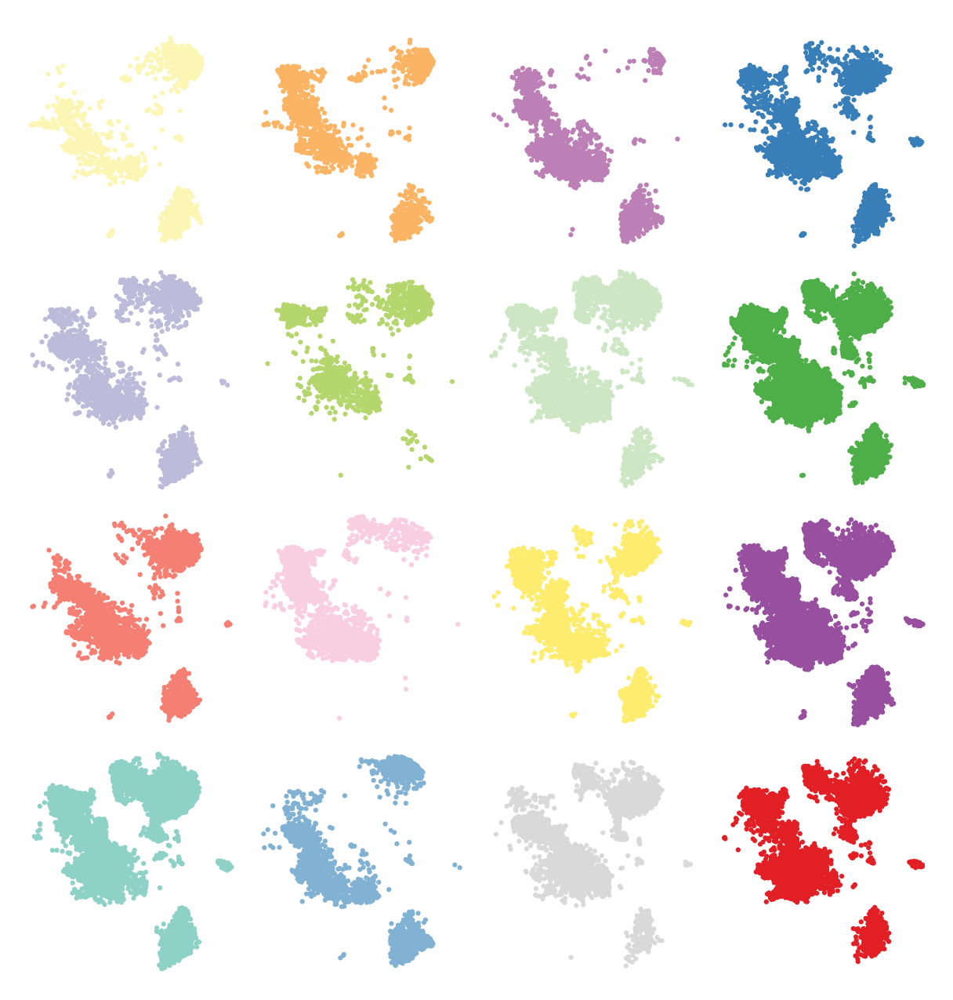

In [6]:
# Plot 16 plots for the individuals.
colors = ["#8ED1C6","#FCF6B5", "#BEBAD9", "#F47F72", "#81B1D3", "#FBB463", "#B4D66C", "#F9CEE1","#DAD9D9", "#BC80B7",
          "#CDE6C4", "#FEEC6E", "#E31F26", "#387EB9", "#4EAF49", "#984F9F", "#8ED1C6","#FCF6B5", "#BEBAD9"];
fig,ax = plt.subplots(nrows=4,ncols=4, figsize=(7,7),sharex=True, sharey=True)
fig.tight_layout()
plt.subplots_adjust(wspace=-0.1, hspace=0)

batch_name = adata.obs.batch_cov.unique()[0]
batch = adata.obs.ind_cov_disease_cov[adata.obs.batch_cov==batch_name].unique();
batch = np.sort(batch.categories.values)
for ind_i in list(range(16)):
    ind = batch[ind_i]
    col = colors[ind_i]
    sc.pl.umap(adata[adata.obs.ind_cov_disease_cov==ind,], color = "ind_cov_disease_cov", title=None, palette=[col,col], ax=ax[(ind_i-1)%4,math.floor(ind_i/4)], size=20, edgecolor="none")
    ax[(ind_i-1)%4,math.floor(ind_i/4)].get_xaxis().set_visible(False)
    ax[(ind_i-1)%4,math.floor(ind_i/4)].get_yaxis().set_visible(False)
    ax[(ind_i-1)%4,math.floor(ind_i/4)].get_legend().remove()
    ax[(ind_i-1)%4,math.floor(ind_i/4)].set_title("")
    ax[(ind_i-1)%4,math.floor(ind_i/4)].set_aspect("equal")

fig.savefig(figdir+'/'+batch_name+'.ind.png')

# Rank genes and plot leiden groups

In [ ]:
sc.tl.rank_genes_groups(adata, 'leiden', method='t-test', n_genes=25)
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

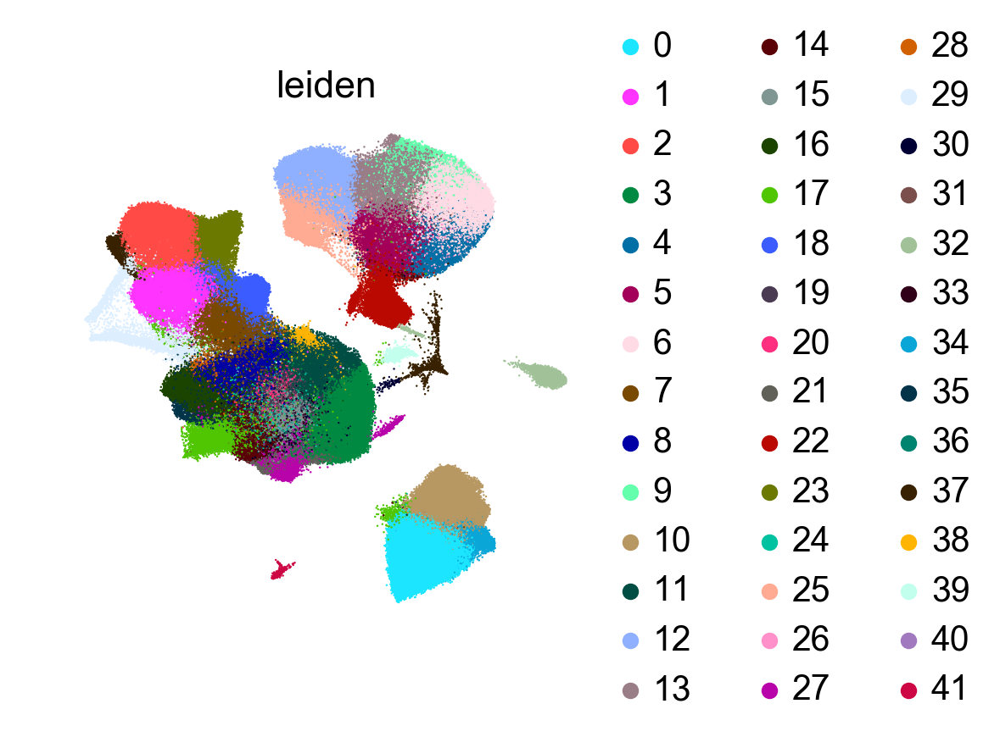

In [7]:
sc.pl.umap(adata, color='leiden', size=3, show=True, edgecolor="none", save='.leiden.png', palette=MASTERCOLORS)

# Most expressed genes per leiden group

In [ ]:
pd.set_option('display.max_columns', None)
unique_leiden = np.unique(adata.obs['leiden'].values)
# Compile list of top genes
GeneRanks = pd.DataFrame()
for ii in range(len(unique_leiden)):
    GeneRanks[str('leiden_' + str(ii))] = adata.var_names[np.flipud(np.argsort(np.mean(adata.X[adata.obs['leiden'] == str(ii)], axis=0)))]
GeneRanks.to_csv('Flare_study_top_expression.csv')
GeneRanks.head(10)

# Label cell populations

In [11]:
adata.obs['ct_cov'] = adata.obs['ct_cov'].astype('object')
adata.obs['ct_cov'].loc[adata.obs.leiden == "0"] = "B Cells" ## good                                                                                    
adata.obs['ct_cov'].loc[adata.obs.leiden == "1"] = "Cytotoxic T Cells" ## good                                                                                    
adata.obs['ct_cov'].loc[adata.obs.leiden == "2"] = "Natural Killer Cells" ## good                                                                                     
adata.obs['ct_cov'].loc[adata.obs.leiden == "3"] = "Naive T Cells" ## good                                                                                    
adata.obs['ct_cov'].loc[adata.obs.leiden == "4"] = "Classical Monocytes" ## good    Effector Memory T Cells                                                                                 
adata.obs['ct_cov'].loc[adata.obs.leiden == "5"] = "Classical Monocytes" ## good                                                                                    
adata.obs['ct_cov'].loc[adata.obs.leiden == "6"] = "Classical Monocytes" ## good                                                                                    
adata.obs['ct_cov'].loc[adata.obs.leiden == "7"] = "Cytotoxic T Cells" ## good        Nonclassical Monocytes                                                                            
adata.obs['ct_cov'].loc[adata.obs.leiden == "8"] = "Effector Memory T Cells" ## good     Classical Dendritic Cells                                                                               
adata.obs['ct_cov'].loc[adata.obs.leiden == "9"] = "Classical Monocytes" ## good                                                                                    
adata.obs['ct_cov'].loc[adata.obs.leiden == "10"] = "B Cells" ## good     Megakaryocytes                                                                             
adata.obs['ct_cov'].loc[adata.obs.leiden == "11"] = "Naive T Cells" ## good Plasmacytoid Dendritic Cells                                                                                   
adata.obs['ct_cov'].loc[adata.obs.leiden == "12"] = "Nonclassical Monocytes" ## good                                                                                   
adata.obs['ct_cov'].loc[adata.obs.leiden == "13"] = "Classical Monocytes" ## good  Macro    Proliferating T Cells                                                                             
adata.obs['ct_cov'].loc[adata.obs.leiden == "14"] = "Doublets" ## good                                                                                  
adata.obs['ct_cov'].loc[adata.obs.leiden == "15"] = "Naive T Cells" ## good                                                                                   
adata.obs['ct_cov'].loc[adata.obs.leiden == "16"] = "T-Reg T Cells" ## good                                                                                   
adata.obs['ct_cov'].loc[adata.obs.leiden == "17"] = "Doublets" ## good                                                                                  
adata.obs['ct_cov'].loc[adata.obs.leiden == "18"] = "Cytotoxic T Cells" ## good  
adata.obs['ct_cov'].loc[adata.obs.leiden == "19"] = "Naive T Cells" ## good
adata.obs['ct_cov'].loc[adata.obs.leiden == "20"] = "Naive T Cells" ## good
adata.obs['ct_cov'].loc[adata.obs.leiden == "21"] = "Naive T Cells" ## good
adata.obs['ct_cov'].loc[adata.obs.leiden == "22"] = "Classical Dendritic Cells" ## good
adata.obs['ct_cov'].loc[adata.obs.leiden == "23"] = "Natural Killer Cells" ## good
adata.obs['ct_cov'].loc[adata.obs.leiden == "24"] = "Naive T Cells" ## good
adata.obs['ct_cov'].loc[adata.obs.leiden == "25"] = "Nonclassical Monocytes" ## good
adata.obs['ct_cov'].loc[adata.obs.leiden == "26"] = "Classical Monocytes" ## good
adata.obs['ct_cov'].loc[adata.obs.leiden == "27"] = "Progenitor Cells" ## good
adata.obs['ct_cov'].loc[adata.obs.leiden == "28"] = "Effector Memory T Cells" ## good
adata.obs['ct_cov'].loc[adata.obs.leiden == "29"] = "Proliferating T Cells" ## good
adata.obs['ct_cov'].loc[adata.obs.leiden == "30"] = "RBCs" ## good
adata.obs['ct_cov'].loc[adata.obs.leiden == "31"] = "Classical Monocytes" ## good
adata.obs['ct_cov'].loc[adata.obs.leiden == "32"] = "Plasmacytoid Dendritic Cells" ## good
adata.obs['ct_cov'].loc[adata.obs.leiden == "33"] = "Naive T Cells" ## good
adata.obs['ct_cov'].loc[adata.obs.leiden == "34"] = "B Cells" ## good
adata.obs['ct_cov'].loc[adata.obs.leiden == "35"] = "Naive T Cells" ## good
adata.obs['ct_cov'].loc[adata.obs.leiden == "36"] = "Naive T Cells" ## good
adata.obs['ct_cov'].loc[adata.obs.leiden == "37"] = "RBCs" ## good
adata.obs['ct_cov'].loc[adata.obs.leiden == "38"] = "Naive T Cells" ## good
adata.obs['ct_cov'].loc[adata.obs.leiden == "39"] = "Megakaryocytes" ## good
adata.obs['ct_cov'].loc[adata.obs.leiden == "40"] = "Naive T Cells" ## good
adata.obs['ct_cov'].loc[adata.obs.leiden == "41"] = "B Cells" ## good
adata.obs['ct_cov'] = adata.obs.ct_cov.astype('category')

# Example protein plots

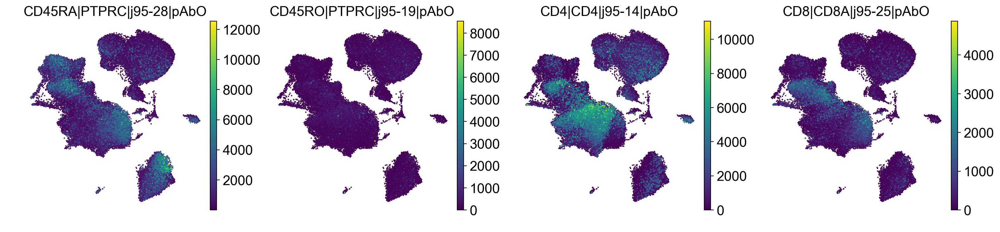

In [12]:
sc.pl.umap(adata, color=['CD45RA|PTPRC|j95-28|pAbO', 'CD45RO|PTPRC|j95-19|pAbO', 'CD4|CD4|j95-14|pAbO', 'CD8|CD8A|j95-25|pAbO'], size=10)

# Plot cell types

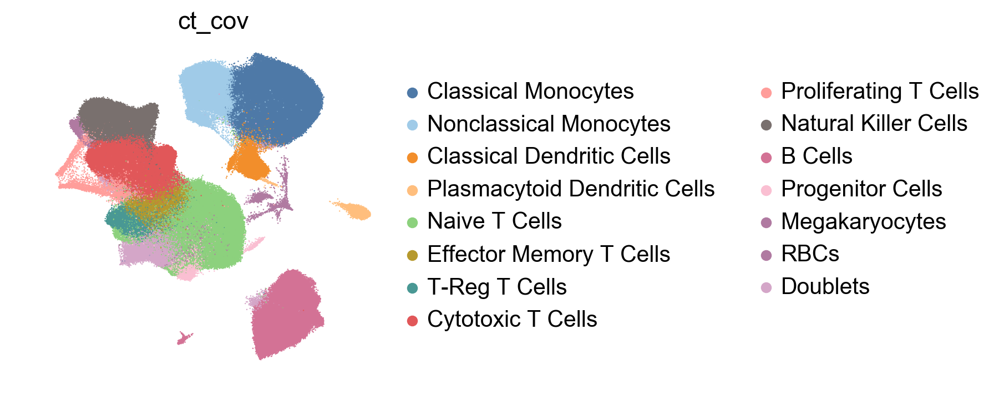

In [13]:
sc.settings.set_figure_params(dpi=100, dpi_save=300, format='png', frameon=False, transparent=True, fontsize=16)
plt.rcParams["image.aspect"] = "equal"
MasterORDER = ['Classical Monocytes', 'Nonclassical Monocytes', 'Classical Dendritic Cells', 'Plasmacytoid Dendritic Cells',
               'Naive T Cells', 'Effector Memory T Cells', 'T-Reg T Cells', 'Cytotoxic T Cells', 'Proliferating T Cells',
               'Natural Killer Cells', 'B Cells', 'Progenitor Cells', 'Megakaryocytes', 'RBCs', 'Doublets']

colorrs = ["#4E79A7","#A0CBE8","#F28E2B","#FFBE7D","#8CD17D","#B6992D","#499894","#E15759","#FF9D9A","#79706E",
           "#D37295","#FABFD2", '#B07AA1',"#B07AA1","#D4A6C8","#9D7660","#E58606", "#5D69B1", "#24796C",
           '#DAA51B', '#000000', '#99C945', '#ED645A']

adata.obs['ct_cov'] = adata.obs['ct_cov'].cat.reorder_categories(MasterORDER)
adata.uns['ct_cov_colors'] = colorrs
celltype_umap = sc.pl.umap(adata, color='ct_cov', show=True, size=3, edgecolor="none")

# Remove RBCs and Doublets from further analysis

In [14]:
adata = adata[~adata.obs['ct_cov'].isin(['RBCs', 'Doublets'])]

Trying to set attribute `.obs` of view, copying.


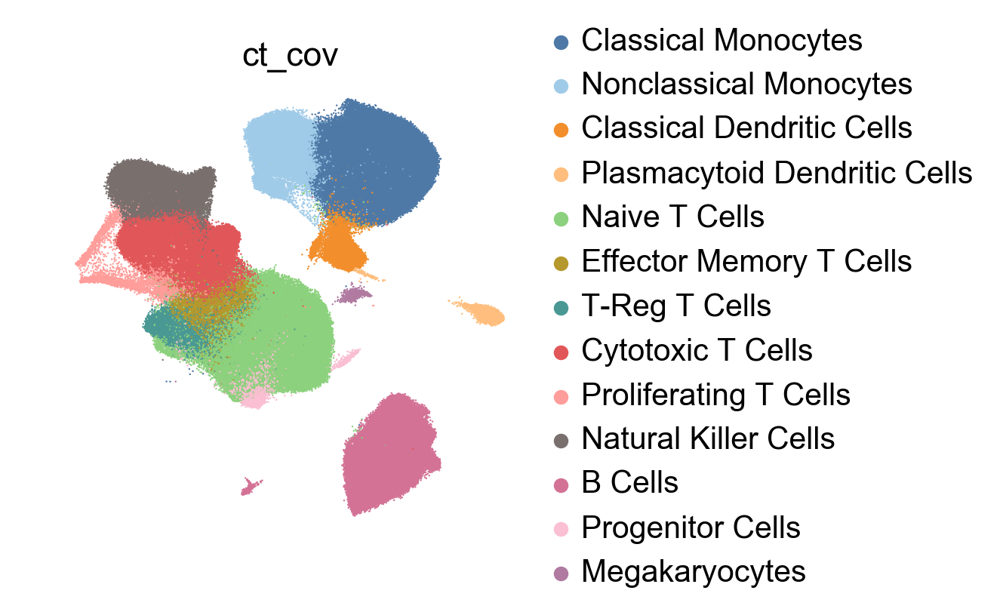

In [15]:
sc.settings.set_figure_params(dpi=100, dpi_save=300, format='png', frameon=False, transparent=True, fontsize=16)
plt.rcParams["image.aspect"] = "equal"
MasterORDER = ['Classical Monocytes','Nonclassical Monocytes', 'Classical Dendritic Cells', 'Plasmacytoid Dendritic Cells', 'Naive T Cells', 'Effector Memory T Cells', 'T-Reg T Cells','Cytotoxic T Cells', 'Proliferating T Cells', 'Natural Killer Cells', 'B Cells', 'Progenitor Cells', 'Megakaryocytes']
adata.obs['ct_cov'] = adata.obs['ct_cov'].cat.reorder_categories(MasterORDER)
adata.uns['ct_cov_colors'] = colorrs
celltype_umap = sc.pl.umap(adata, color='ct_cov', show=True, size=3, edgecolor="none")

# Proportions and Statistics

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


['Healthy'] versus ['Managed', 'Treated', 'Flare']


,Beta,Cell,Pval
0,12.391251578182729,Classical Monocytes,7.09899e-14
1,1.5276937949148155,Nonclassical Monocytes,0.000121681
2,-0.24675865484115628,Classical Dendritic Cells,0.028578
3,-0.5125997538536277,Plasmacytoid Dendritic Cells,1.70385e-26
4,-18.472839600008676,Naive T Cells,2.65255e-35
5,1.0687744337311362,Effector Memory T Cells,0.0059667
6,0.09904610211640098,T-Reg T Cells,0.600416
7,4.645534096187444,Cytotoxic T Cells,0.000324379
8,0.35713497510359765,Proliferating T Cells,3.80445e-05
9,-0.5175272177647207,Natural Killer Cells,0.407437


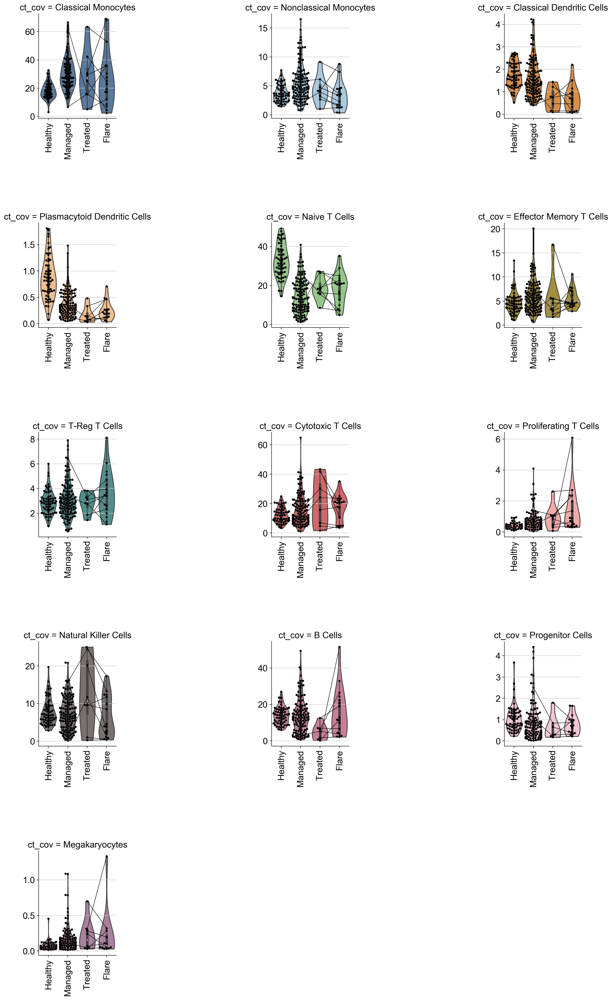

In [90]:
## Make proportion plots
adata_obs_small = adata.obs
ind_count = adata_obs_small.groupby(['ind_cov_disease_cov','ct_cov','disease_cov', 'ind_cov'])['ct_cov'].count()
ind_count_sums = ind_count.groupby(level=[0]).sum()
ind_count_sums = ind_count_sums.reset_index(name="counts")
ind_perc = ind_count/ind_count.groupby(level=[0]).transform(sum)*100
ind_perc = ind_perc.reset_index(name="ct_perc")
# Add weights to WLS
ind_perc['counts'] = ind_count.values.tolist()

ind_perc['ind_count_sum'] = list(np.zeros(len(ind_count.values.tolist()),dtype=int))
# Add total sums per individual to structure
for ii in range(len(ind_count_sums)):
    ind_perc['ind_count_sum'][ind_perc.ind_cov_disease_cov==ind_count_sums.ind_cov_disease_cov[ii]] = ind_count_sums.counts[ii]

ind_perc.ind_cov_disease_cov = ind_perc.ind_cov_disease_cov.apply(lambda x: x.split('_')[0])
ind_count_sums.ind_cov_disease_cov = ind_count_sums.ind_cov_disease_cov.apply(lambda x: x.split('_')[0])
ind_perc.ind_cov_disease_cov = ind_perc.ind_cov_disease_cov.astype("str")
ind_perc.reset_index(inplace=True)
ind_perc.ct_cov = ind_perc.ct_cov.astype('category')
ind_perc.ct_cov = ind_perc.ct_cov.cat.reorder_categories(adata.obs.ct_cov.cat.categories.values)

perc_plot = sns.catplot(x='disease_cov', y='ct_perc', order=[ "Healthy", "Managed", "Treated", "Flare"], hue='ct_cov', data=ind_perc, kind='violin', col_order=MasterORDER, col='ct_cov', col_wrap=3, cut=0, dodge=False, aspect=1, sharex=False, sharey=False, palette=colorrs)

for ct_i in list(range(len(MasterORDER))):
    ct = MasterORDER[ct_i]
    sns.swarmplot(x="disease_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], order=[ "Healthy", "Managed", "Treated", "Flare"], color="0", size=4, ax=perc_plot.axes[ct_i])
    try:
        sns.pointplot(x="disease_cov", y="ct_perc", hue="ind_cov", data=ind_perc[ind_perc.ct_cov == ct], order=[ "Healthy", "Managed", "Treated", "Flare"], color="0", scale=0.3, ax=perc_plot.axes[ct_i])
    except:
        continue
    perc_plot.axes[ct_i].get_yaxis().label.set_visible(False)
    perc_plot.axes[ct_i].get_xaxis().label.set_visible(False)
    perc_plot.axes[ct_i].get_legend().remove()
    perc_plot.set_xticklabels(rotation=90)
    perc_plot.fig.subplots_adjust(wspace=2, hspace = 1)
    
perc_plot.savefig(figdir+"/violin.ct_cov_figure6b.png")
perc_plot.savefig(figdir+"/violin.ct_cov_figure6b.pdf")

def get_proportion_stats(ind_perc, group1, group2):
    print('{0} versus {1}'.format(group1, group2))
    all_out = pd.DataFrame();
    ind_perc0 = ind_perc[ind_perc.disease_cov.isin(group1+group2)]
    Effect = {}
    for ct_i in list(range(len(ind_perc0.ct_cov.cat.categories))):
        ct = ind_perc0.ct_cov.cat.categories[ct_i]
        ct_perc = ind_perc0.ct_perc[ind_perc0.ct_cov==ct]
        weights = ind_perc0.ind_count_sum[ind_perc0.ct_cov==ct]
        disease = ind_perc0.disease_cov[ind_perc0.ct_cov==ct]
        disease = disease.astype("str")
        disease.values[disease.isin(group1)] = 0
        disease.values[disease.isin(group2)] = 1
        disease = sm.add_constant(disease)
        est=sm.WLS(ct_perc.astype(float), disease.astype(float), weights=weights)
        est=est.fit()
        effect=est.params[1]
        pval=est.pvalues[1]
        HEALTHYMANAGED_effect[ct] = effect
        all_out = all_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval)}), ignore_index=True)
        all_out['Pval'] = all_out['Pval'].astype(float)
    def highlight_max(p):
        sig = p < (0.01/len(p))
        return ['background-color: yellow' if v else '' for v in sig]
    all_out = all_out.style.apply(highlight_max, subset=['Pval'])   
    display(all_out)

get_proportion_stats(ind_perc, group1=['Healthy'], group2=['Managed', 'Treated', 'Flare'])

In [91]:
def getproportions(celltype, group1, group2):
    print('{0} proportion for celltype: {1}: {2}' .format(group1, celltype, np.round(ind_perc[ind_perc.disease_cov==group1][ind_perc.ct_cov==celltype].ct_perc.mean(),2)))
    print('{0} proportion for celltype: {1}: {2}' .format(group2, celltype, np.round(ind_perc[ind_perc.disease_cov==group2][ind_perc.ct_cov==celltype].ct_perc.mean(),2)))

getproportions(celltype='Classical Monocytes',group1='Healthy', group2='Managed')


Healthy proportion for celltype: Classical Monocytes: 18.14
Managed proportion for celltype: Classical Monocytes: 30.72


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  
/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  This is separate from the ipykernel package so we can avoid doing imports until


# Get differential gene expression for each cell population in psuedobulk

In [93]:
def get_pseudobulk(adata):
    genes = adata.raw.var_names.tolist()
    people = np.unique(adata.obs['ind_cov'].tolist())
    pseudobulk = pd.DataFrame(index=genes, columns=people)
    for ii in range(len(people)):
        fdata = adata[adata.obs['ind_cov'] == people[ii]]
        pseudobulk[people[ii]] = np.ravel(np.sum(fdata.raw.X, axis=0)/len(fdata))
    return pseudobulk

def compute_LogFC(pseudobulk, SLE_people, healthy_people):
    logFC = {}; pval  = {}
    genes = pseudobulk.transpose().keys().tolist()
    for ii in range(len(genes)):
        h = pseudobulk[healthy_people].transpose()[genes[ii]].values
        s = pseudobulk[SLE_people].transpose()[genes[ii]].values
        _, p = stats.ranksums(s,h)
        pval[genes[ii]] = p
        s = np.nanmean(s)
        h = np.nanmean(h)
        logFC[genes[ii]] = np.log2(np.divide(s+10**-3,h+10**-3))
    return logFC, pval

def make_volcanoplot(logFC, pval, title):
    num_std = 6 # Number of standard deviations above/below mean for gene log2 FC cutoff.
    pval_cutoff = 9 # 10^-n (0.001/~39000) allows for 1/1000 false alarm rate corrected for # genes
    s = np.std(np.asarray(list(logFC.values())))
    upper = np.mean(np.asarray(list(logFC.values()))) + (np.std(np.asarray(list(logFC.values())))*num_std)
    lower = np.mean(np.asarray(list(logFC.values()))) - (np.std(np.asarray(list(logFC.values())))*num_std)
    genes = np.asarray(list(logFC.keys()))
    x = np.asarray(list(logFC.values()))
    y = np.log10(list(pval.values()))*-1
    sc.settings.set_figure_params(dpi=150, dpi_save=300, format='png', frameon=False, transparent=True, fontsize=12)
    # Plot non-significant values
    sns.scatterplot(x[(x<=upper) & (x>=lower) & (y<=pval_cutoff)], y[(x<=upper) & (x>=lower) & (y<=pval_cutoff)], color=[0.5, 0.5, 0.5], alpha=0.2)
    sns.scatterplot(x[(x<upper) & (y>pval_cutoff)], y[(x<upper) & (y>pval_cutoff)], color=[0.5, 0.5, 0.5], alpha=0.2)
    sns.scatterplot(x[(x>lower) & (y>pval_cutoff)], y[(x>lower) & (y>pval_cutoff)], color=[0.5, 0.5, 0.5], alpha=0.2)
    # Plot significant values
    sns.scatterplot(x[(x>upper) & (y>pval_cutoff)], y[(x>upper) & (y>pval_cutoff)], color='#a1caf1')
    sns.scatterplot(x[(x<lower) & (y>pval_cutoff)], y[(x<lower) & (y>pval_cutoff)], color='#a1caf1')
    plt.xlabel('Log2 Fold Change')
    plt.ylabel('-Log10 p-value')
    plt.title('Volcano plot: {}'.format(title))
    for ii in range(len(genes[(x>upper) & (y>pval_cutoff)])):
        plt.text(x[(x>upper) & (y>pval_cutoff)][ii], y[(x>upper) & (y>pval_cutoff)][ii], s=genes[(x>upper) & (y>pval_cutoff)][ii], fontsize=5)

    for ii in range(len(genes[(x<lower) & (y>pval_cutoff)])):
        plt.text(x[(x<lower) & (y>pval_cutoff)][ii], y[(x<lower) & (y>pval_cutoff)][ii], s=genes[(x<lower) & (y>pval_cutoff)][ii], fontsize=5)
    
    URG = genes[(x>upper) & (y>pval_cutoff)]
    DRG = genes[(x<lower) & (y>pval_cutoff)]
    return URG, DRG
    

## Log2 FC for Total PBMC psuedobulk

In [94]:
def get_totalPBMC_log2FC(adata):
    healthy_people = np.unique(adata.obs['ind_cov'][adata.obs['SLE status']=='Healthy'].tolist())
    SLE_people = np.unique(adata.obs['ind_cov'][adata.obs['SLE status']=='SLE'].tolist())
    pseudobulk_totalPBMC = get_pseudobulk(adata)
    logFC_totalPBMC, pval_totalPBMC = compute_LogFC(pseudobulk_totalPBMC, SLE_people, healthy_people)
    data = pd.DataFrame(list(logFC_totalPBMC.values()), index=list(logFC_totalPBMC.keys()), columns=['Log2FC'])
    data2 = pd.DataFrame(list(pval_totalPBMC.values()), index=list(pval_totalPBMC.keys()), columns=['p-value'])
    data = pd.concat([data, data2], axis=1)
    data = data.transpose()
    data.to_csv('Log2FC-SLEvsHealthy-totalPBMC.csv')
    return logFC_totalPBMC, pval_totalPBMC

#logFC_totalPBMC, pval_totalPBMC = get_totalPBMC_log2FC(adata)

tmp = pd.read_csv('Log2FC-SLEvsHealthy-totalPBMC.csv', index_col=0)
logFC_totalPBMC = tmp.transpose()['Log2FC'].to_dict()
pval_totalPBMC = tmp.transpose()['p-value'].to_dict()

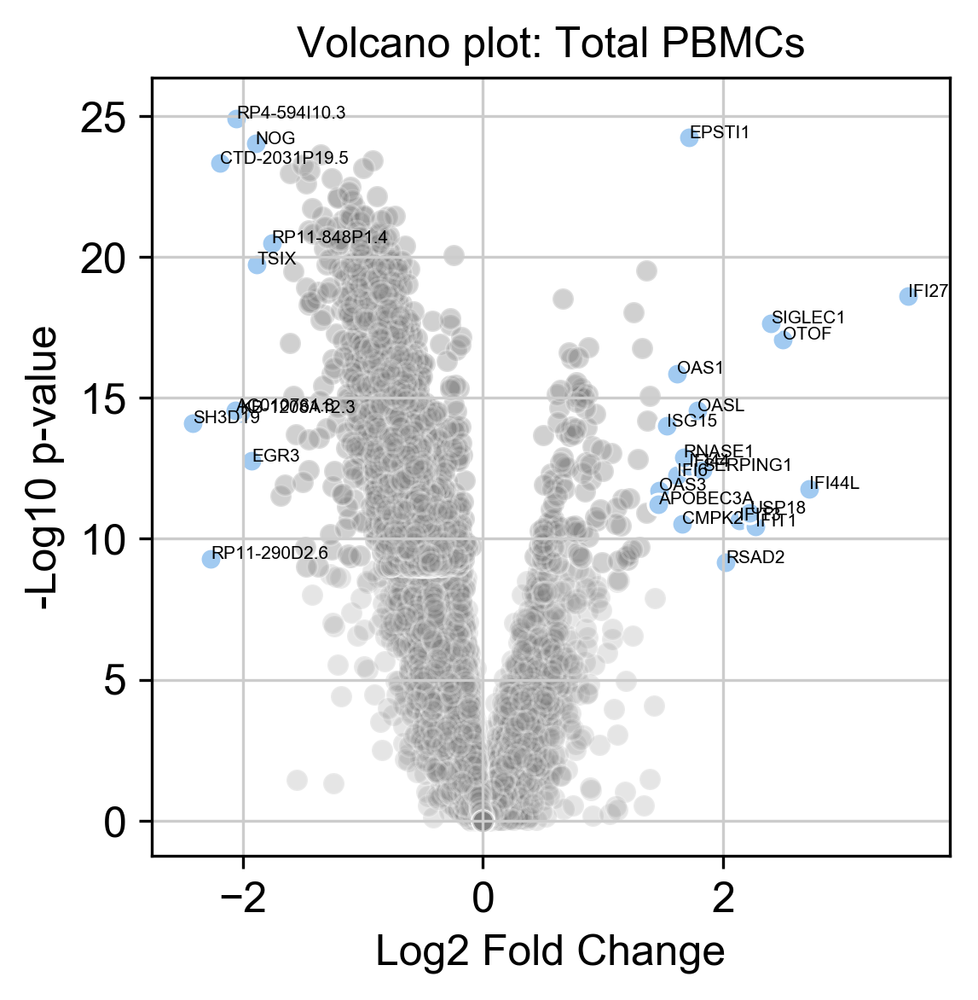

In [95]:
URG_total, DRG_total = make_volcanoplot(logFC_totalPBMC, pval_totalPBMC, title='Total PBMCs')

# Log2 FC for each subpopulation

In [96]:
def run_subpop_log2FC(adata):
    ct_groups = np.unique(adata.obs['ct_cov'].tolist())
    logFC_groups = {}; pval_groups = {};
    for ii in range(len(ct_groups)):
        print('Cell type: {}'.format(ct_groups[ii]))
        fdata = adata[adata.obs['ct_cov']==ct_groups[ii]]
        healthy_people = np.unique(fdata.obs['ind_cov'][fdata.obs['SLE status']=='Healthy'].tolist())
        SLE_people = np.unique(fdata.obs['ind_cov'][fdata.obs['SLE status']=='SLE'].tolist())
        pseudobulk = get_pseudobulk(fdata)
        logFC, pval = compute_LogFC(pseudobulk, SLE_people, healthy_people)
        logFC_groups[ct_groups[ii]] = logFC
        pval_groups[ct_groups[ii]] = pval
        data = pd.DataFrame(list(logFC_groups[ct_groups[ii]].values()), index=list(logFC_groups[ct_groups[ii]].keys()), columns=['Log2FC'])
        data2 = pd.DataFrame(list(pval_groups[ct_groups[ii]].values()), index=list(pval_groups[ct_groups[ii]].keys()), columns=['p-value'])
        data = pd.concat([data, data2], axis=1)
        data = data.transpose()
        data.to_csv('Log2FC-SLEvsHealthy-{}.csv'.format(ct_groups[ii]))
        
def load_subpop_log2FC(adata):
    ct_groups = np.unique(adata.obs['ct_cov'].tolist())
    logFC_groups = {}; pval_groups = {};
    for ii in range(len(ct_groups)):
        tmp = pd.read_csv('Log2FC-SLEvsHealthy-{}.csv'.format(ct_groups[ii]), index_col=0)
        logFC_groups[ct_groups[ii]] = tmp.transpose()['Log2FC'].to_dict()
        pval_groups[ct_groups[ii]] = tmp.transpose()['p-value'].to_dict()
    return logFC_groups, pval_groups
    
#run_subpop_log2FC(adata)

logFC_groups, pval_groups = load_subpop_log2FC(adata)


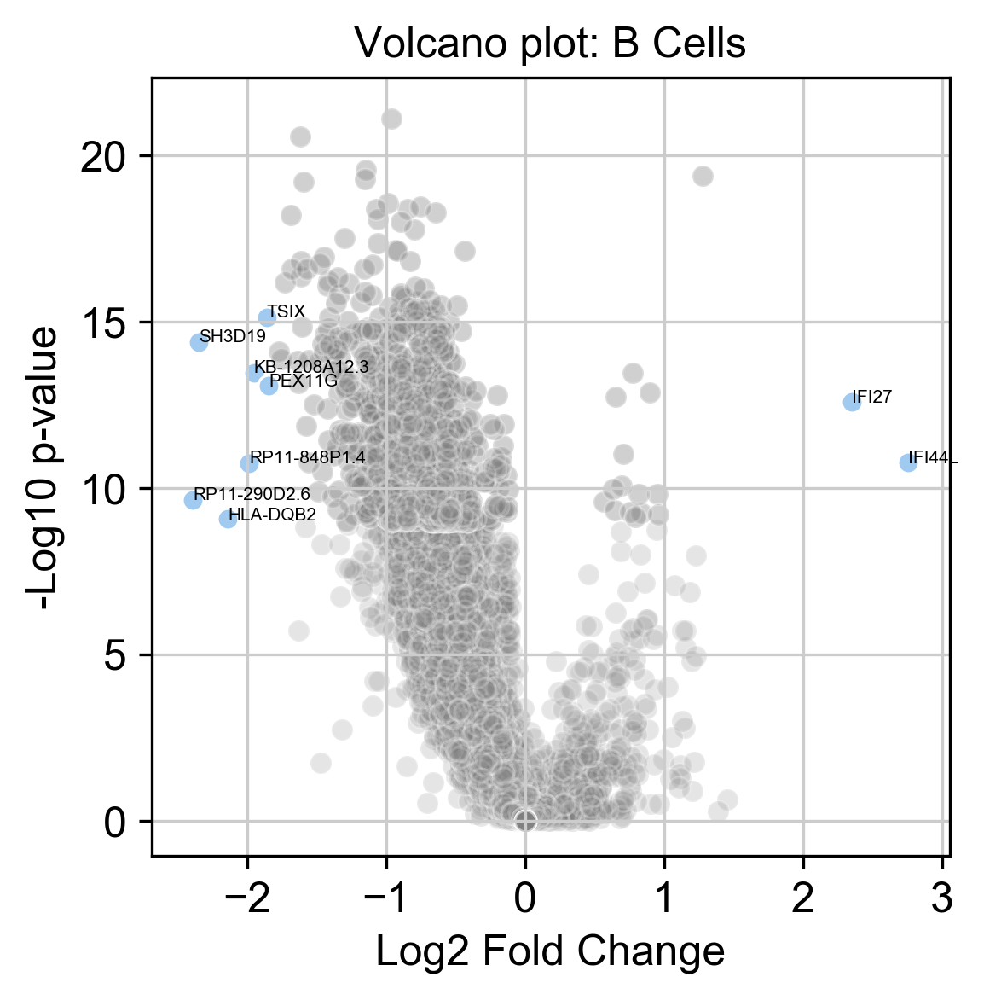

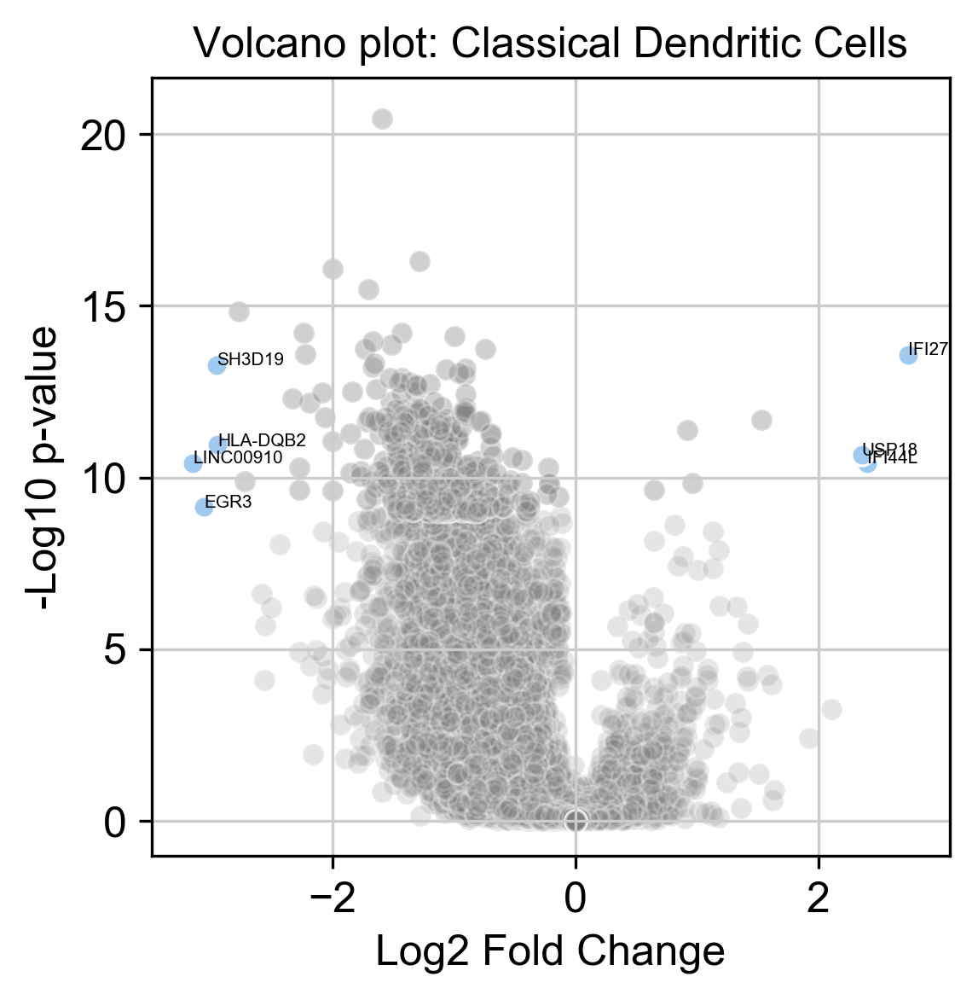

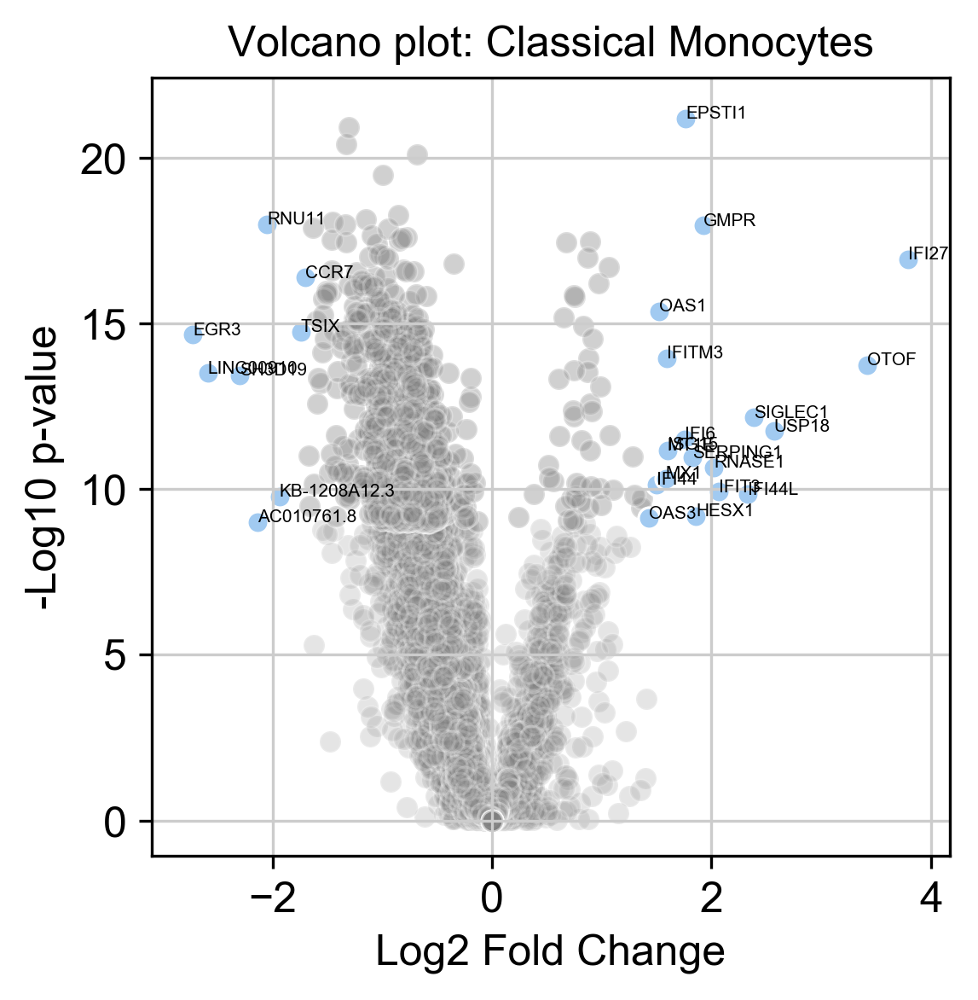

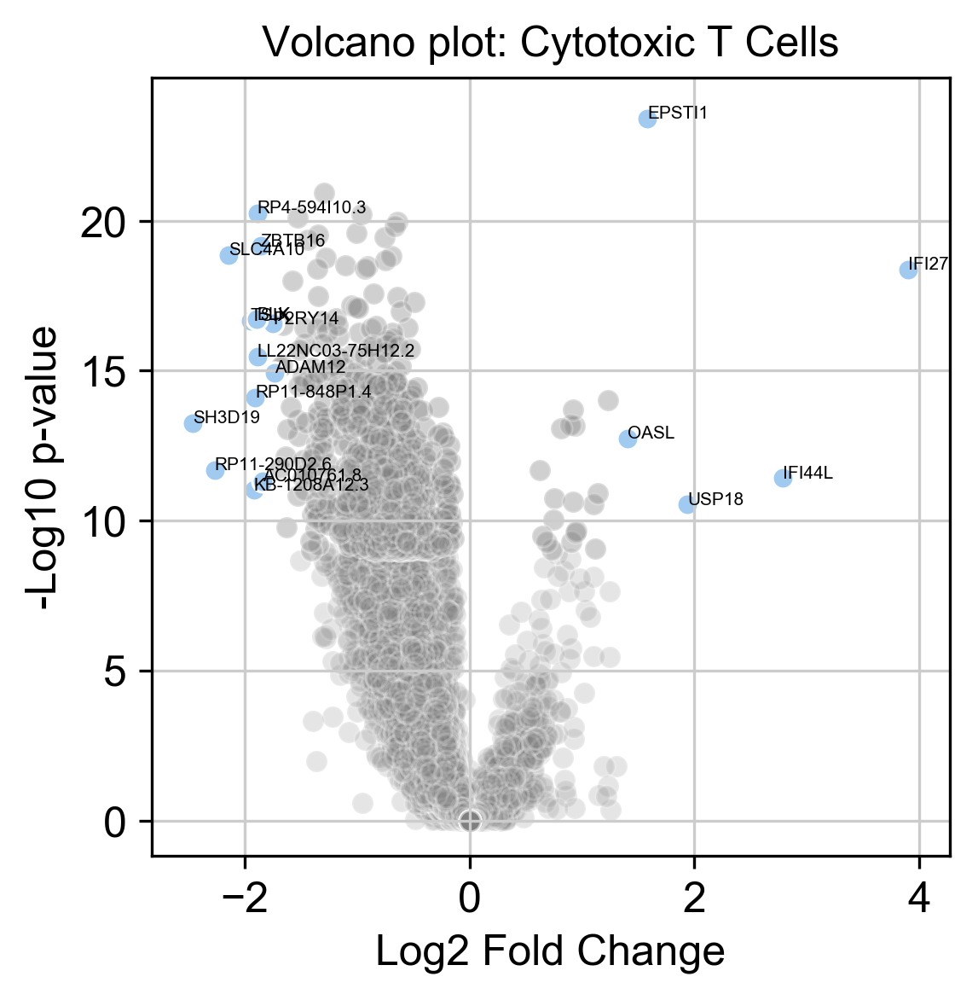

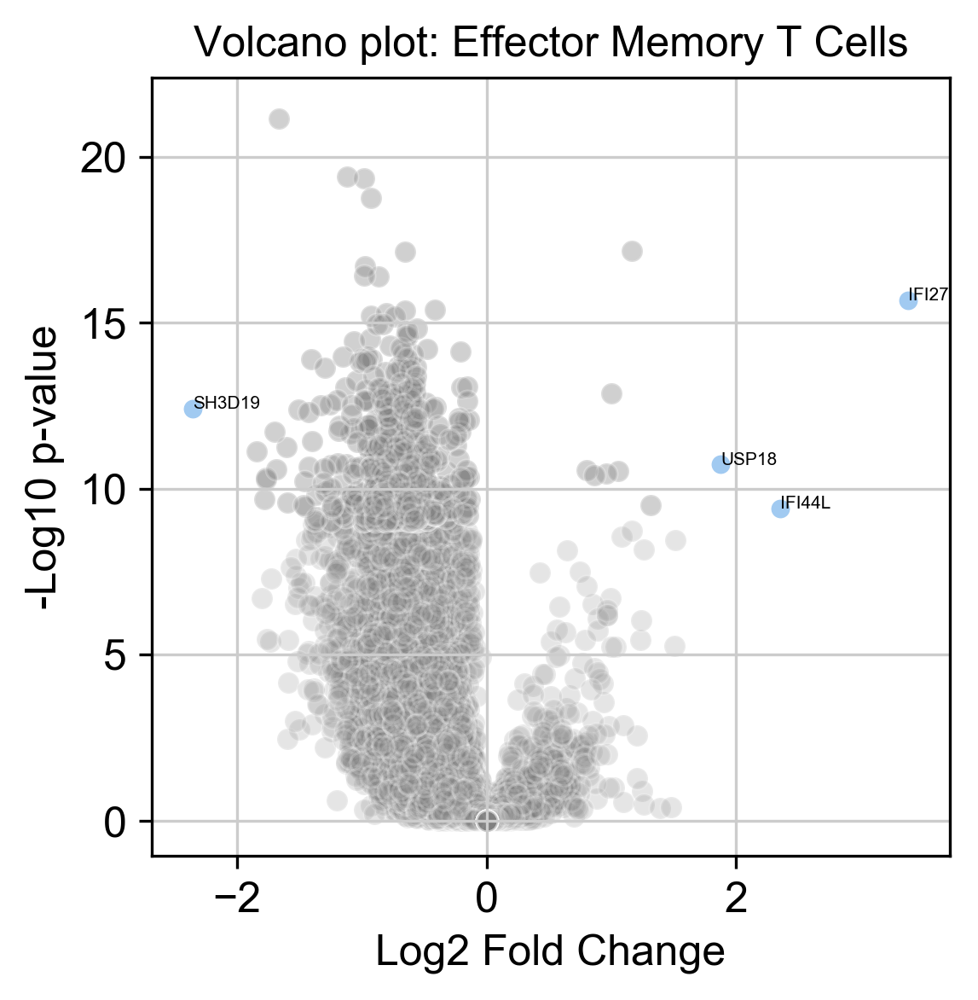

...

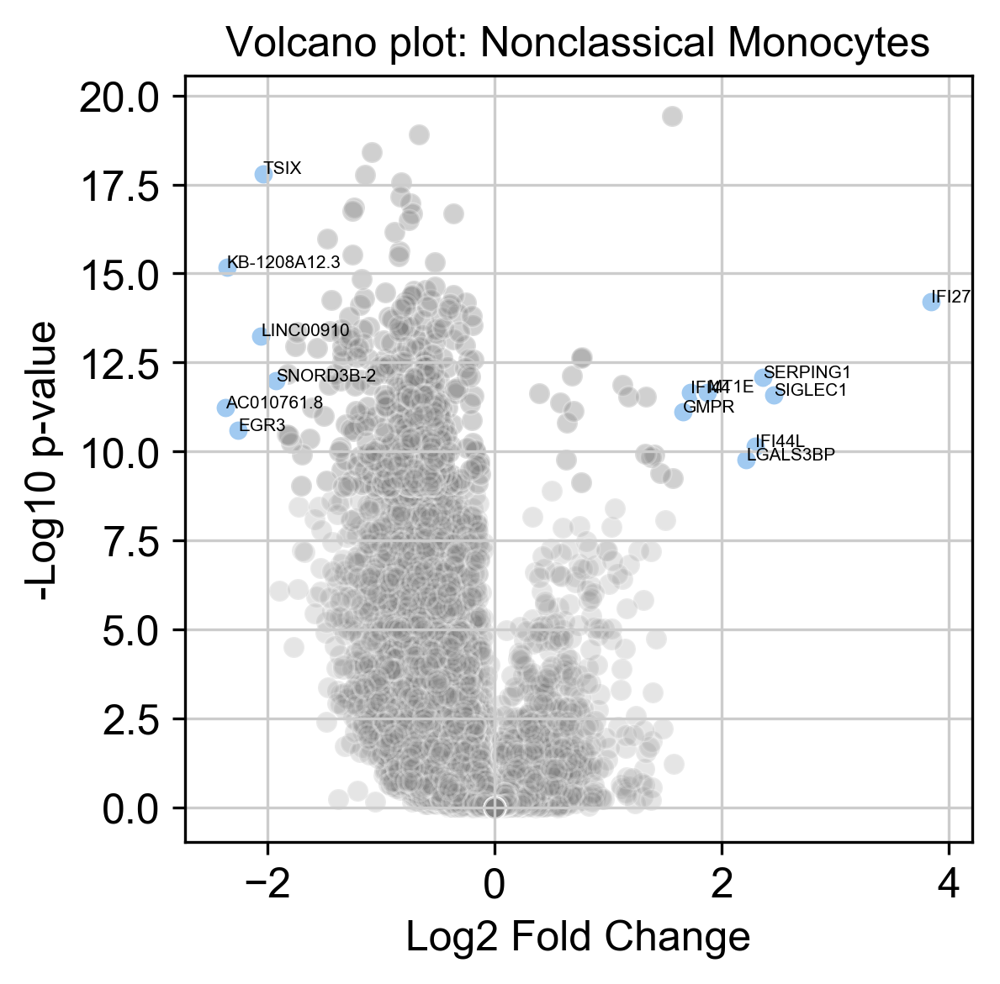

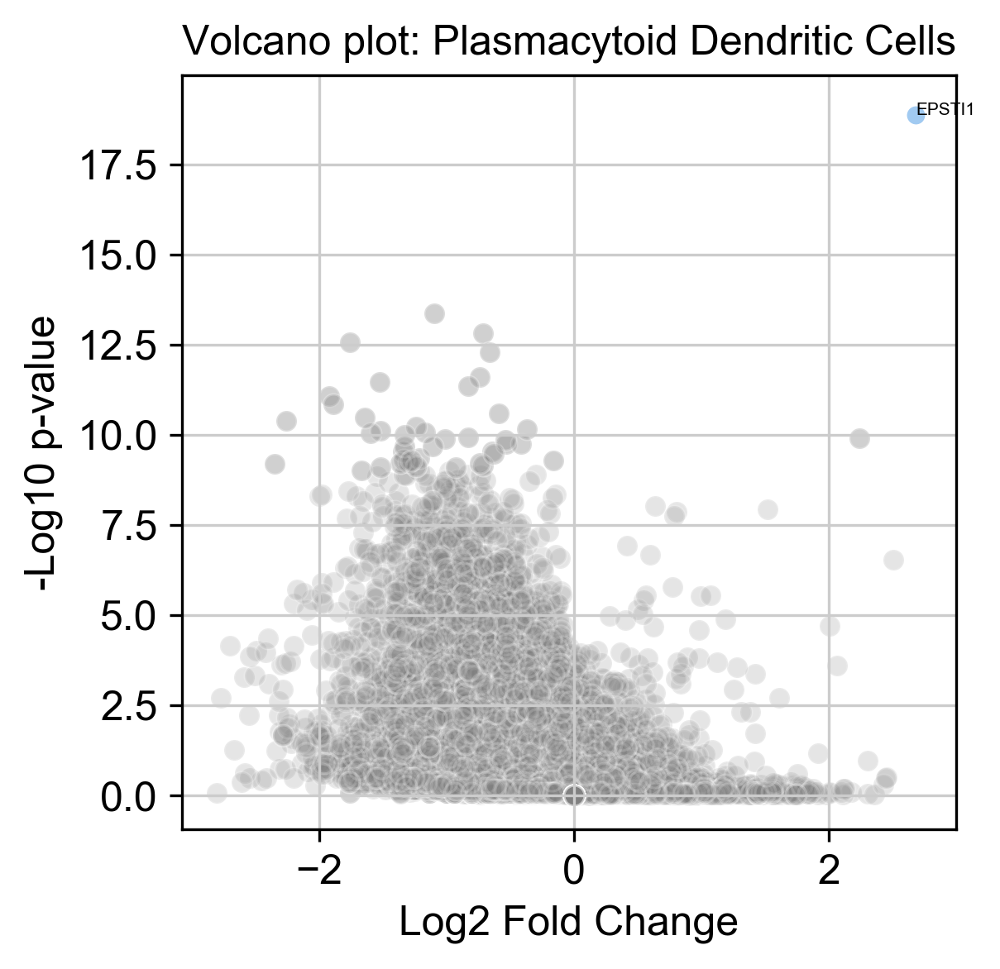

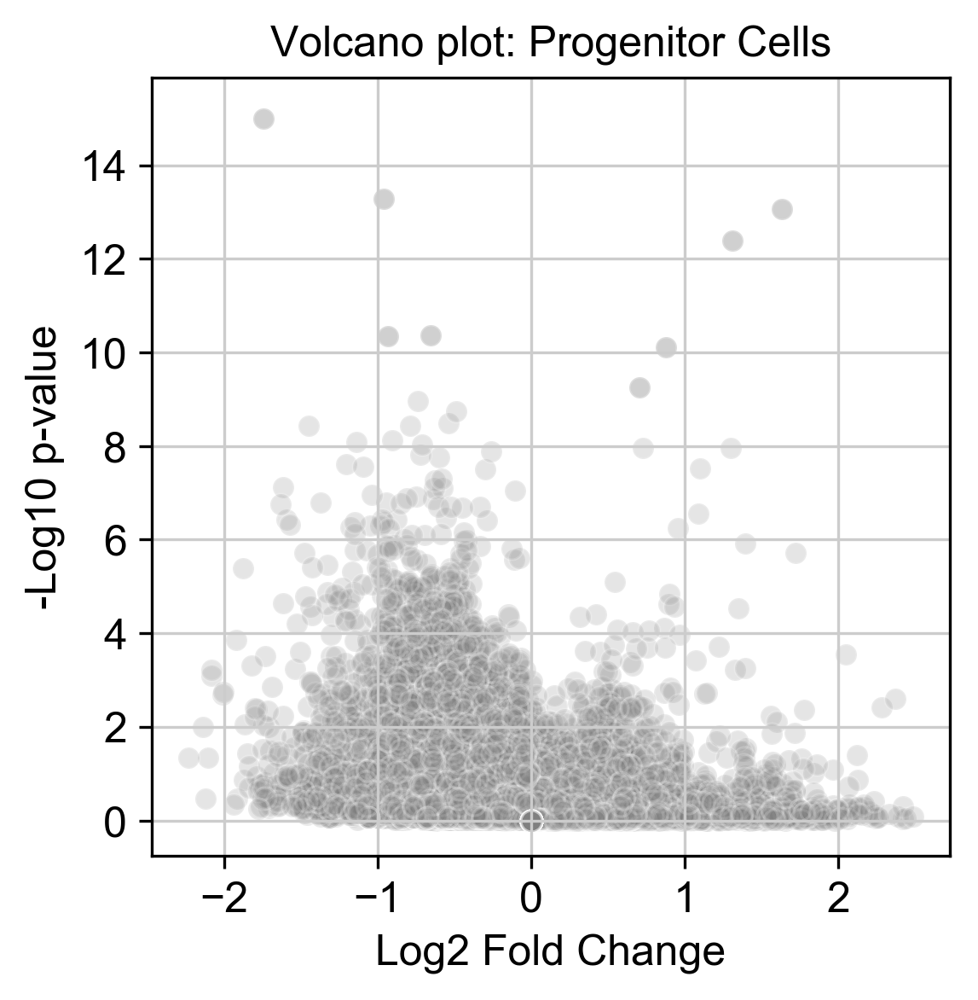

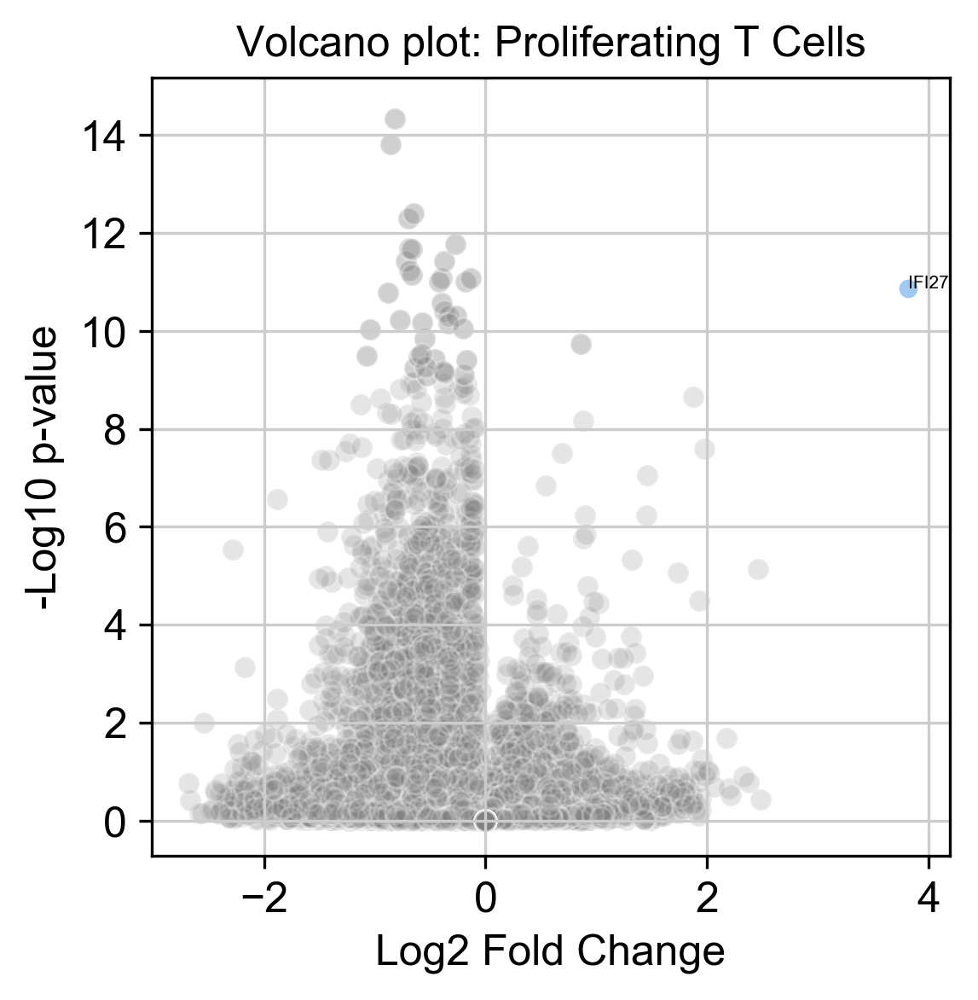

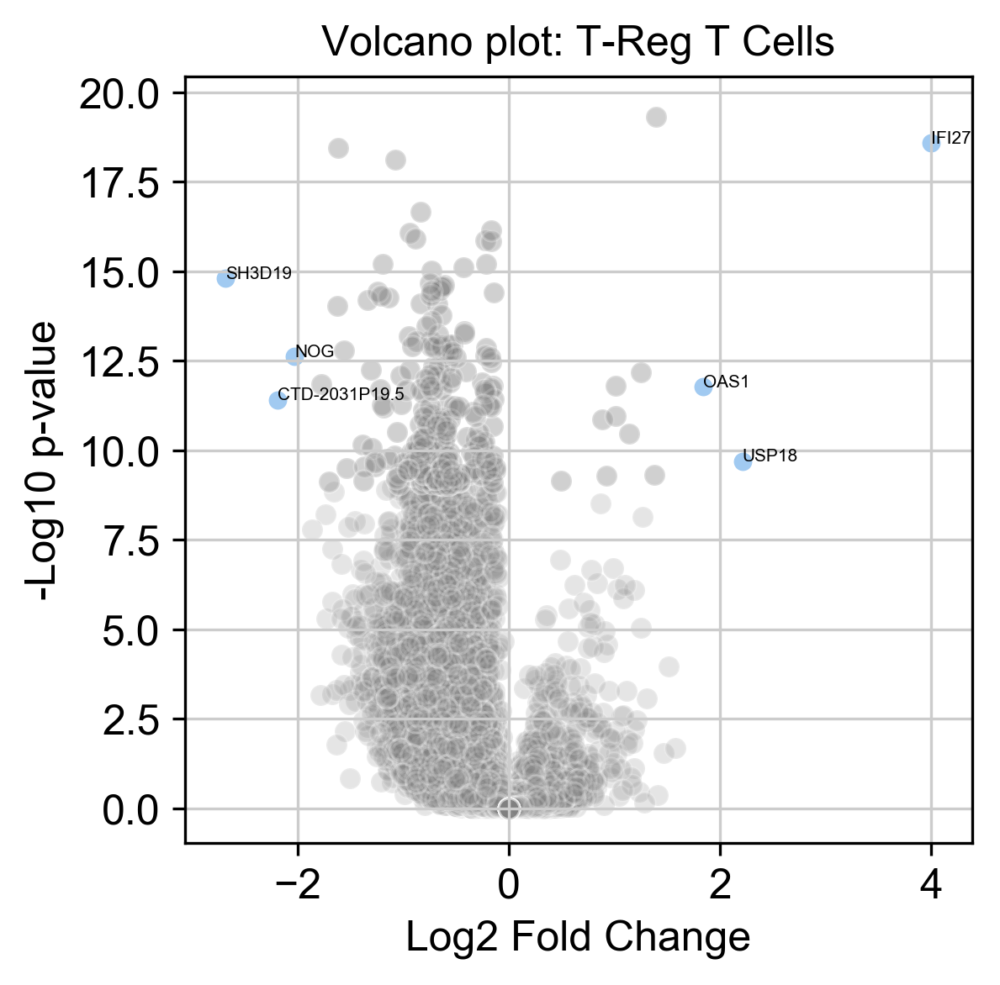

In [97]:
URG = {}; DRG = {}; # Up and Down Regulated Genes for each population
ct_groups = np.unique(adata.obs['ct_cov'].tolist())
for ii in range(len(ct_groups)):
    plt.figure()
    URG[ct_groups[ii]], DRG[ct_groups[ii]] = make_volcanoplot(logFC_groups[ct_groups[ii]], pval_groups[ct_groups[ii]], ct_groups[ii])
    

# Cell Type Specific Genes

In [98]:
ct_groups = np.unique(adata.obs['ct_cov'].tolist())
URG_exclude = {}; DRG_exclude = {}
for ii in range(len(ct_groups)):
    listURG = list(URG[ct_groups[ii]])
    listDRG = list(DRG[ct_groups[ii]])
    removallist = list(set(URG[ct_groups[ii]]).intersection(URG_total))
    removallistD = list(set(DRG[ct_groups[ii]]).intersection(DRG_total))
    for item in removallist:
        listURG.remove(item)
    for item in removallistD:
        listDRG.remove(item)
    URG_exclude[ct_groups[ii]] = listURG
    DRG_exclude[ct_groups[ii]] = listDRG

# Run the numbers

In [108]:
keys = list(URG.keys())
print('Number of Differentially Expressed Genes:')
print('Total PBMC: {0}, Up: {1}, Down: {2}'.format(len(URG_total)+len(DRG_total), len(URG_total), len(DRG_total)))
for ii in range(len(keys)):
    print('{0} Total: {1}, Up: {2}, Down: {3}'.format(keys[ii],len(URG[keys[ii]])+len(DRG[keys[ii]]), len(URG[keys[ii]]), len(DRG[keys[ii]])))
    print('{0} Specific: {1}, Up: {2}, Down: {3}'.format(keys[ii],len(URG_exclude[keys[ii]])+len(DRG_exclude[keys[ii]]), len(URG_exclude[keys[ii]]), len(DRG_exclude[keys[ii]])))
           

Number of Differentially Expressed Genes:
Total PBMC: 29, Up: 19, Down: 10
B Cells Total: 9, Up: 2, Down: 7
B Cells Specific: 2, Up: 0, Down: 2
Classical Dendritic Cells Total: 7, Up: 3, Down: 4
Classical Dendritic Cells Specific: 2, Up: 0, Down: 2
Classical Monocytes Total: 27, Up: 19, Down: 8
Classical Monocytes Specific: 8, Up: 5, Down: 3
Cytotoxic T Cells Total: 18, Up: 5, Down: 13
Cytotoxic T Cells Specific: 6, Up: 0, Down: 6
Effector Memory T Cells Total: 4, Up: 3, Down: 1
Effector Memory T Cells Specific: 0, Up: 0, Down: 0
Megakaryocytes Total: 5, Up: 2, Down: 3
Megakaryocytes Specific: 0, Up: 0, Down: 0
Naive T Cells Total: 21, Up: 8, Down: 13
Naive T Cells Specific: 5, Up: 1, Down: 4
Natural Killer Cells Total: 15, Up: 5, Down: 10
Natural Killer Cells Specific: 6, Up: 0, Down: 6
Nonclassical Monocytes Total: 14, Up: 8, Down: 6
Nonclassical Monocytes Specific: 5, Up: 3, Down: 2
Plasmacytoid Dendritic Cells Total: 1, Up: 1, Down: 0
Plasmacytoid Dendritic Cells Specific: 0, Up: 0

# Gene Ontology analysis

In [270]:
from __future__ import print_function
from Bio import Entrez
from goatools.base import download_go_basic_obo
from goatools.base import download_ncbi_associations
from goatools.obo_parser import GODag
from goatools.anno.genetogo_reader import Gene2GoReader
from goatools.test_data.genes_NCBI_9606_ProteinCoding import GENEID2NT as GeneID2nt_hsa
from goatools.goea.go_enrichment_ns import GOEnrichmentStudyNS
from goatools.godag_plot import plot_gos, plot_results, plot_goid2goobj
# Store gene summaries
summary_dict = {}
def getgeneids(gene_list):
    Entrez.email = "richard.perez@ucsf.edu"
    # Store symbol and id
    geneid2symbol = {}
    for genesymbol in gene_list:
        try:
            handle = Entrez.esearch(db="gene", term=str(genesymbol + "[GENE] AND Homo"))
            record = Entrez.read(handle)
            geneid2symbol[int(record['IdList'][0])] = genesymbol
            handle.close()
        except:
            continue
    return geneid2symbol

def id2symbol(GENES, celltypes, cdata):
    for geneID in GENES:
        Entrez.email = "richard.perez@ucsf.edu"
        id_list= [str(geneID)]
        request = Entrez.epost("gene",id=",".join(id_list))
        result = Entrez.read(request)
        webEnv = result["WebEnv"]
        queryKey = result["QueryKey"]
        data = Entrez.esummary(db="gene", webenv=webEnv, query_key=queryKey)
        annotations = Entrez.read(data)
        symbol  = annotations['DocumentSummarySet']['DocumentSummary'][0]['Name']
        summary = annotations['DocumentSummarySet']['DocumentSummary'][0]['Summary']
        print(symbol); print(summary)
        ind_perc = plot_gene_expression(cdata, celltypes, symbol)
    return symbol, summary

def id2symbolfast(gene_id):
    Entrez.email = "richard.perez@ucsf.edu"
    id_list= [str(gene_id)]
    request = Entrez.epost("gene",id=",".join(id_list))
    result = Entrez.read(request)
    webEnv = result["WebEnv"]
    queryKey = result["QueryKey"]
    data = Entrez.esummary(db="gene", webenv=webEnv, query_key=queryKey)
    annotations = Entrez.read(data)
    symbol  = annotations['DocumentSummarySet']['DocumentSummary'][0]['Name']
    summary = annotations['DocumentSummarySet']['DocumentSummary'][0]['Summary']
    return symbol, summary

def replace_id_with_symbol(results, summary_dict):
    for ll in range(len(results['study_items'])):
        study_item = np.asarray(results['study_items'][ll].split(','), dtype=int)
        # Keep all gene summaries
        for ii in range(len(study_item)):
            symbol, summary = id2symbolfast(study_item[ii])
            summary_dict[symbol] = summary
        # Replace gene ID with gene symbol
        study_item = [id2symbolfast(study_item[ii])[0] for ii in range(len(study_item))]
        results['study_items'][ll]= study_item
    return results, summary_dict

def run_GO(gene_list, cutoff, title):
    obo_fname = download_go_basic_obo()
    fin_gene2go = download_ncbi_associations()
    obodag = GODag("go-basic.obo")

    # Read NCBI's gene2go. Store annotations in a list of namedtuples
    objanno = Gene2GoReader(fin_gene2go, taxids=[9606])

    # Get namespace2association where:
    #    namespace is:
    #        BP: biological_process               
    #        MF: molecular_function
    #        CC: cellular_component
    #    assocation is a dict:
    #        key: NCBI GeneID
    #        value: A set of GO IDs associated with that gene
    ns2assoc = objanno.get_ns2assc()

    for nspc, id2gos in ns2assoc.items():
        print("{NS} {N:,} annotated human genes".format(NS=nspc, N=len(id2gos)))

    goeaobj = GOEnrichmentStudyNS(
            GeneID2nt_hsa.keys(), # List of human protein-coding genes
            ns2assoc, # geneid/GO associations
            obodag, # Ontologies
            propagate_counts = False,
            alpha = cutoff, # default significance cut-off
            methods = ['fdr_bh']) # defult multipletest correction method

    geneid2symbol = getgeneids(gene_list)
    # 'p_' means "pvalue". 'fdr_bh' is the multiple test method
    geneids_study = geneid2symbol.keys()
    goea_results_all = goeaobj.run_study(geneids_study)
    goea_results_sig = [r for r in goea_results_all if r.p_fdr_bh < cutoff]
    '''
    This plot contains GOEA results:

    GO terms colored by P-value:
    pval < 0.005 (light red)
    pval < 0.01 (light orange)
    pval < 0.05 (yellow)
    pval > 0.05 (grey) Study terms that are not statistically significant
    GO terms with study gene counts printed. e.g., "32 genes"
    '''
    plot_results(title+"{NS}.png", goea_results_sig, id2symbol=geneid2symbol, study_items=20, items_p_line=5)
    goeaobj.wr_xlsx(title+".xlsx", goea_results_sig, id2symbol=geneid2symbol)
    return geneid2symbol, goea_results_sig

In [1020]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', 100)
ct_groups = ['Classical Monocytes'] #np.unique(adata.obs['ct_cov'].tolist())
for ii in range(len(ct_groups)):
    try:
        gene_list = DRG_total#URG[ct_groups[ii]]
        cutoff = 0.05
        title = '{}-URG-Lupus_Study'.format(ct_groups[ii])
        run_GO(gene_list, cutoff, title)
        results = pd.read_excel(title + ".xlsx")
        results, summary_dict = replace_id_with_symbol(results, summary_dict)
        print(ct_groups[ii])
    except:
        continue
    display(results)

  EXISTS: go-basic.obo
  EXISTS: gene2go
go-basic.obo: fmt(1.2) rel(2020-02-21) 47,245 GO Terms
HMS:0:00:04.032261 323,776 annotations, 20,488 genes, 18,228 GOs, 1 taxids READ: gene2go 
CC 19,579 annotated human genes
BP 18,452 annotated human genes
MF 17,426 annotated human genes

Load BP Gene Ontology Analysis ...
 80% 16,763 of 20,913 population items found in association

Load CC Gene Ontology Analysis ...
 85% 17,763 of 20,913 population items found in association

Load MF Gene Ontology Analysis ...
 80% 16,670 of 20,913 population items found in association

Run BP Gene Ontology Analysis: current study set of 4 IDs ...
100%      3 of      3 study items found in association
 75%      3 of      4 study items found in population(20913)
Calculating 12,156 uncorrected p-values using fisher
  12,156 GO terms are associated with 16,763 of 20,913 population items
      75 GO terms are associated with      3 of      4 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.0

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:64: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Classical Monocytes


,GO,NS,enrichment,name,ratio_in_study,ratio_in_pop,p_uncorrected,depth,study_count,p_fdr_bh,study_items
0,GO:0060700,BP,e,regulation of ribonuclease activity,3/19,4/20913,2.541552e-09,7,3,0.000031,"[OAS1, OAS3, OASL]"
1,GO:0009615,BP,e,response to virus,7/19,103/20913,2.892282e-08,5,7,0.000176,"[IFIT1, IFIT3, OAS1, OAS3, OASL, IFI44, RSAD2]"
2,GO:0045071,BP,e,negative regulation of viral genome replication,7/19,40/20913,4.354867e-08,7,7,0.000176,"[IFIT1, OAS1, OAS3, OASL, ISG15, RSAD2, APOBEC3A]"
3,GO:0060337,BP,e,type I interferon signaling pathway,9/19,66/20913,3.383417e-07,7,9,0.001028,"[IFI6, IFI27, IFIT1, IFIT3, OAS1, OAS3, OASL, ISG15, RSAD2]"
4,GO:0051607,BP,e,defense response to virus,11/19,190/20913,6.157596e-07,6,11,0.001497,"[IFI6, IFI27, IFIT1, IFIT3, OAS1, OAS3, OASL, ISG15, IFI44L, RSAD2, APOBEC3A]"
5,GO:0001730,MF,e,2'-5'-oligoadenylate synthetase activity,2/19,3/20913,2.344769e-06,6,2,0.009733,"[OAS1, OAS3]"


## Average Cell-Type-Gene-Expression

In [298]:
pseudobulk = get_pseudobulk(adata)
corr_matrix = pd.DataFrame(index=list(pseudobulk.columns))
corr_matrix['URG-Total-PBMC'] = pseudobulk.transpose()[URG_total].mean(axis=1).values
corr_matrix['DRG-Total-PBMC'] = pseudobulk.transpose()[DRG_total].mean(axis=1).values

ct_groups = np.unique(adata.obs['ct_cov'].tolist())
for ii in range(len(ct_groups)):
    try:
        print('Cell type: {}'.format(ct_groups[ii]))
        fdata = adata[adata.obs['ct_cov'] == ct_groups[ii]]
        pseudobulk = get_pseudobulk(fdata)
        corr_matrix['URG-{}'.format(ct_groups[ii])] = pseudobulk.transpose()[URG[ct_groups[ii]]].mean(axis=1).values
        corr_matrix['DRG-{}'.format(ct_groups[ii])] = pseudobulk.transpose()[DRG[ct_groups[ii]]].mean(axis=1).values
        corr_matrix['URG-SansPan-{}'.format(ct_groups[ii])] = pseudobulk.transpose()[URG_exclude[ct_groups[ii]]].mean(axis=1).values
        corr_matrix['DRG-SansPan-{}'.format(ct_groups[ii])] = pseudobulk.transpose()[DRG_exclude[ct_groups[ii]]].mean(axis=1).values
    except:
        continue
corr_matrix.to_csv('Expression-Composition-Average-Expression.csv'

Cell type: B Cells
Cell type: Classical Dendritic Cells
Cell type: Classical Monocytes
Cell type: Cytotoxic T Cells
Cell type: Effector Memory T Cells
Cell type: Megakaryocytes
Cell type: Naive T Cells
Cell type: Natural Killer Cells
Cell type: Nonclassical Monocytes
Cell type: Plasmacytoid Dendritic Cells
Cell type: Progenitor Cells
Cell type: Proliferating T Cells
Cell type: T-Reg T Cells


In [109]:
corr_matrix = pd.read_csv('Expression-Composition-Average-Expression.csv', index_col=0)
# Drop NaN covariates
corr_matrix = corr_matrix.dropna(axis=1)

# Compute composition of each cell type per person

In [110]:
def add_proportions(corr_matrix, adata):
    ## Make proportion plots
    adata_obs_small = adata.obs
    ind_count = adata_obs_small.groupby(['ind_cov', 'ct_cov','SLE status'])['ct_cov'].count()
    ind_count_sums = ind_count.groupby(level=[0]).sum()
    ind_count_sums = ind_count_sums.reset_index(name="counts")
    ind_perc = ind_count/ind_count.groupby(level=[0]).transform(sum)*100
    ind_perc = ind_perc.reset_index(name="ct_perc")

        # Add composition changes
    people = corr_matrix.index.tolist()
    ct_groups = np.unique(adata.obs['ct_cov'].tolist())
    for jj in range(len(ct_groups)):
        tmp = ind_perc[ind_perc['ct_cov']==ct_groups[jj]]
        tmplist = np.empty((len(people),))
        tmplist[:] = np.nan
        for ii in range(len(people)):
            try:
                tmplist[ii] = tmp[tmp['ind_cov']==people[ii]]['ct_perc'].values[0]
            except:
                continue
        corr_matrix['Proportion-{}'.format(ct_groups[jj])] = tmplist
    return corr_matrix

corr_matrix = add_proportions(corr_matrix, adata)

# Compute Correlations between URG, DRGs and Cell Type Abundance

In [292]:
def plot_barplot(correlations, label):
    sc.settings.set_figure_params(dpi=150, dpi_save=200, format='png', frameon=False, transparent=True, fontsize=8)
    x = np.asarray(list((correlations[label].values)))
    indices = np.flipud(np.argsort(x)); x = x[indices];
    y = np.asarray(list(correlations[label].index)); y = y[indices]
    x = np.concatenate((x[:10], x[-10:]))
    y = np.concatenate((y[:10], y[-10:]))
    g = sns.barplot(x, y, palette='GnBu_d')
    plt.title('Correlations to {}'.format(label))

def plot_clustermap(corr_matrix, title, fontscale, save):
    corr_matrix[np.isnan(corr_matrix)] = 0
    sc.settings.set_figure_params(dpi=200, dpi_save=300, format='png', frameon=False, transparent=True, fontsize=12)
    sns.set(font_scale=fontscale)
    sns.set(style="white")
    # Generate a mask for the upper triangle
    mask = np.triu(np.ones_like(corr_matrix, dtype=np.bool))
    # Generate a custom diverging colormap
    cmap = sns.diverging_palette(220, 10, as_cmap=True)
    sns.clustermap(corr_matrix, cmap=cmap, center=0, square=True, linewidths=.5)
    plt.title(title)
    if save == True:
        plt.savefig("{}.png".format(title), bbox_inches='tight')
        
def plot_gene_expression(cdata, celltypes, gene, normalize):
    sc.settings.set_figure_params(dpi=75, dpi_save=200, format='png', frameon=False, transparent=True, fontsize=5)
    sns.set(font_scale=1)
    indlist  = cdata.obs['ind_cov'].unique().tolist()
    ind_id = []; dz_id = []; ct_id = []; values = []; count = []
    for celltype in celltypes:
        for ii in range(len(indlist)):
            values.append(cdata.raw.X[(cdata.obs['ct_cov'].values==celltype) & (cdata.obs['ind_cov'].values==indlist[ii]), cdata.raw.var_names==gene].mean())
            count.append(cdata.raw.X[cdata.obs['ind_cov'].values==indlist[ii], cdata.raw.var_names==gene].shape[1])
            normvalues = np.divide(np.asarray(values), np.asarray(count)) # Normalize by cell number
            ind_id.append(indlist[ii])
            dz_id.append(cdata.obs['SLE status'][cdata.obs['ind_cov']==indlist[ii]].values.unique()[0])
            ct_id.append(celltype)
    if normalize == True:
        genexpression = pd.DataFrame(data={'Unique_ID': ind_id, 'disease_cov': dz_id, gene: normvalues, 'Cell_Count':count, 'ct_cov':ct_id}, index=ind_id)    
    else:
        genexpression = pd.DataFrame(data={'Unique_ID': ind_id, 'disease_cov': dz_id, gene: values, 'Cell_Count':count, 'ct_cov':ct_id}, index=ind_id)    
    genexpression.ct_cov = genexpression.ct_cov.astype('category')
    perc_plot = sns.catplot(x='disease_cov', y=gene, order=["Healthy", "SLE"], hue='ct_cov', data=genexpression, kind='violin', col='ct_cov', col_wrap=2, cut=0, dodge=False, aspect=1, sharex=False, sharey=True)
    for ct_i in range(len(celltypes)):
        sns.swarmplot(x="disease_cov", y=gene, data=genexpression[genexpression.ct_cov==celltypes[ct_i]], order=[ "Healthy", "SLE"], color="0", size=6, ax=perc_plot.axes[ct_i])
        try:
            sns.pointplot(x="disease_cov", y=gene, hue="Unique_ID", data=genexpression[genexpression.Cell_Type==celltypes[ct_i]], order=[ "Healthy", "SLE"], color="0", scale=0.3, ax=perc_plot.axes[ct_i])
        except:
            continue
        perc_plot.axes[ct_i].get_xaxis().label.set_visible(False)
        perc_plot.axes[ct_i].get_legend().remove()
        perc_plot.set_xticklabels(rotation=90)
        perc_plot.fig.subplots_adjust(wspace=0.5, hspace = 1)
    return genexpression
        
def build_covar(corr_matrix_mod, keys):
    clincal = pd.read_csv('lupus.sledai.txt', sep='\t')
    inds = list(corr_matrix_mod.transpose().columns)
    # Add study disease status
    disease_status = {}
    for ii in range(len(clincal['genotypeid'])):
        try:
            disease_status[clincal['genotypeid'][ii]] = 1 #np.unique(adata.obs['SLE status'][adata.obs['ind_cov']==clincal['genotypeid'][ii]])[0]
        except:
            disease_status[clincal['genotypeid'][ii]] = 1 #'SLE' # This person by definition of being in sheet has SLE
            #print('Individual: {} not in study data'.format(clincal['genotypeid'][ii]))

    clincal['Disease_status'] = disease_status.values()
    for key in keys:
        covar = {}
        for ii in range(len(inds)):
            if np.sum(clincal['genotypeid'].isin([inds[ii]]).values):
                covar[inds[ii]] = clincal[clincal['genotypeid'].isin([inds[ii]]).values][key].values[0]
            else:
                covar[inds[ii]] = 0
        corr_matrix_mod[key] = list(covar.values())
    return corr_matrix_mod

def add_gene_covar(main_dataframe, gene_dataframe, gene_name):
    main_dataframe = pd.concat([main_dataframe, gene_dataframe.sort_values('Unique_ID')[gene_name]], axis=1)
    return main_dataframe

def quick_OLS(var1, var2, show_summary=False):
    sc.settings.set_figure_params(dpi=100, dpi_save=200, format='png', frameon=False, transparent=True, fontsize=12)
    Var1 = sm.add_constant(var1)
    results = sm.OLS(var2, Var1).fit()
    if show_summary == True:
        print(results.summary())
        plt.figure()
        sns.scatterplot(var1, var2)
        sns.lineplot(var1, results.predict())
        plt.xlabel(var1.name)
        plt.ylabel(var2.name)
    return results

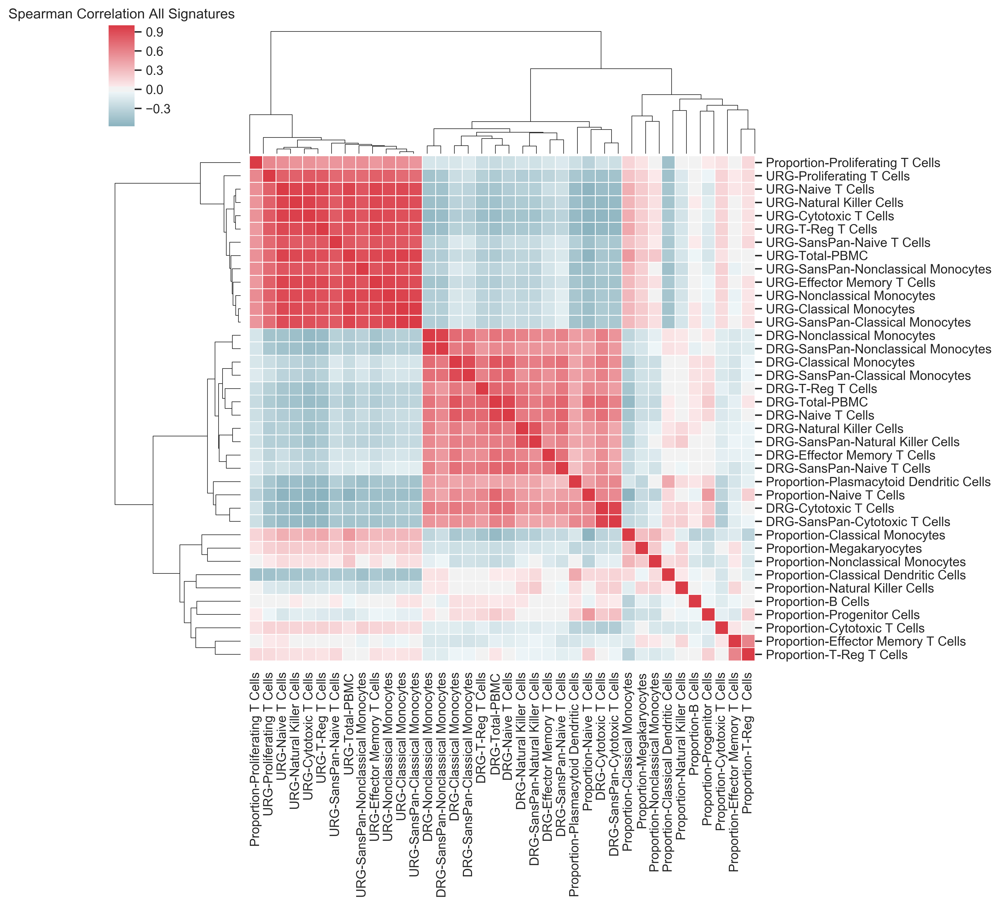

In [112]:
correlations = corr_matrix.corr(method='spearman')
plot_clustermap(correlations, title='Spearman Correlation All Signatures', fontscale=1, save=True)

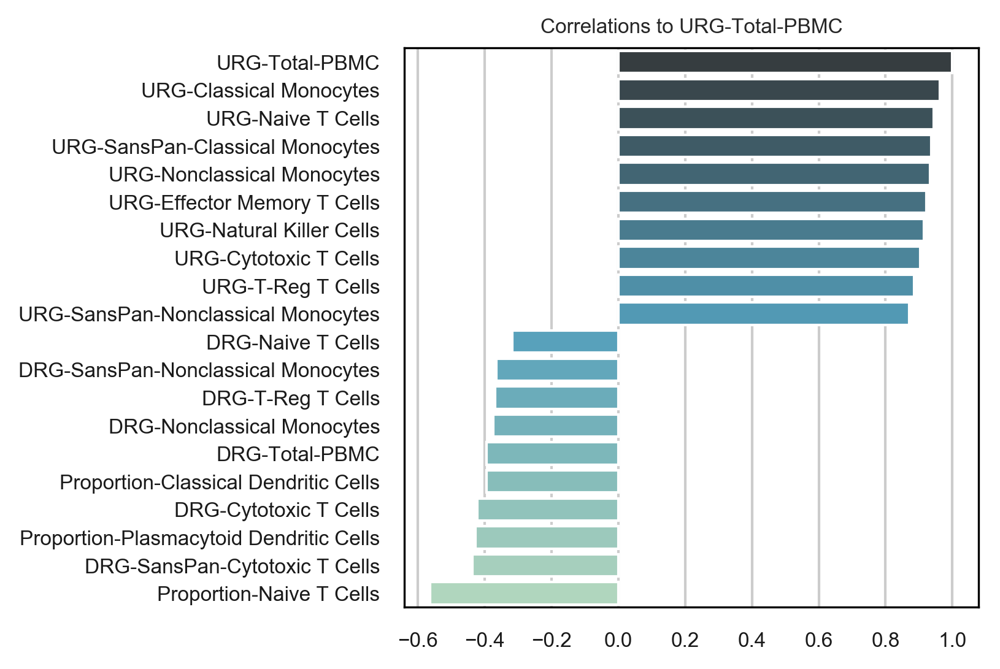

In [128]:
plot_barplot(correlations, label='URG-Total-PBMC')

# Classical Monocyte Signature and Classical Monocyte Specific Signature explains 93% and 87% of Total PBMC Interferon Signature respectively.

## Supporting evidence that Classical Monocytes are responsible for the majority of Type I interferon

[['URG-Total-PBMC' '1.0']
 ['URG-Classical Monocytes' '0.9285251716096156']
 ['URG-Effector Memory T Cells' '0.8779187281139044']
 ['URG-SansPan-Classical Monocytes' '0.8744942950862267']
 ['URG-Nonclassical Monocytes' '0.8627366523311324']
 ['URG-Natural Killer Cells' '0.8562561471700483']
 ['URG-Naive T Cells' '0.8325195333072998']
 ['URG-Cytotoxic T Cells' '0.8304489239070022']
 ['URG-SansPan-Nonclassical Monocytes' '0.8018534233440894']
 ['URG-T-Reg T Cells' '0.7491055761240245']]
                            OLS Regression Results                            
Dep. Variable:         URG-Total-PBMC   R-squared:                       0.929
Model:                            OLS   Adj. R-squared:                  0.928
Method:                 Least Squares   F-statistic:                     2079.
Date:                Sat, 21 Mar 2020   Prob (F-statistic):           1.40e-93
Time:                        15:50:14   Log-Likelihood:                 394.00
No. Observations:                 16

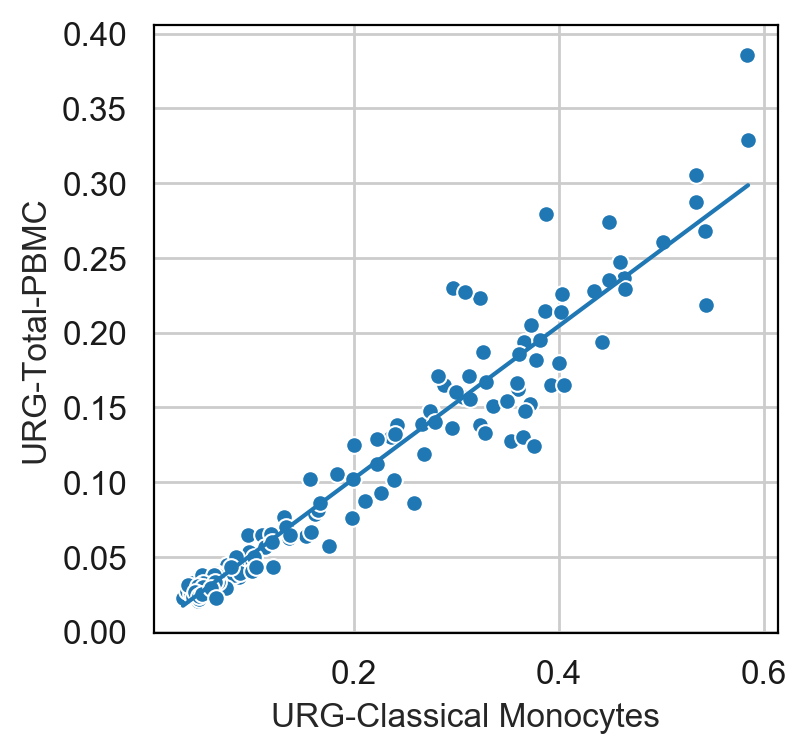

In [299]:
corr_matrix2 = corr_matrix.dropna()
keys = list(corr_matrix2.columns)
R2 = {}
for ii in range(len(keys)):
    results = quick_OLS(corr_matrix2[keys[ii]].values, corr_matrix2['URG-Total-PBMC'].values, show_summary=False)
    R2[keys[ii]] = results.rsquared
R2 = np.flipud(sorted(R2.items(), key=lambda x: x[1]))
print(R2[:10])

results = quick_OLS(corr_matrix2['URG-Classical Monocytes'], corr_matrix2['URG-Total-PBMC'], show_summary=True)



## Collect only Cell Type Specific Signatures

In [130]:
SansPan = [corr_matrix.columns[ii] for ii in range(len(list(corr_matrix.columns))) if corr_matrix.columns[ii].split('-')[1] == 'SansPan']
SansPan = corr_matrix.transpose()[corr_matrix.columns.isin(SansPan)].transpose()
SansPan = add_proportions(SansPan, adata)
SansPan['URG-Total-PBMC'] = corr_matrix['URG-Total-PBMC'].values
SansPan['DRG-Total-PBMC'] = corr_matrix['DRG-Total-PBMC'].values

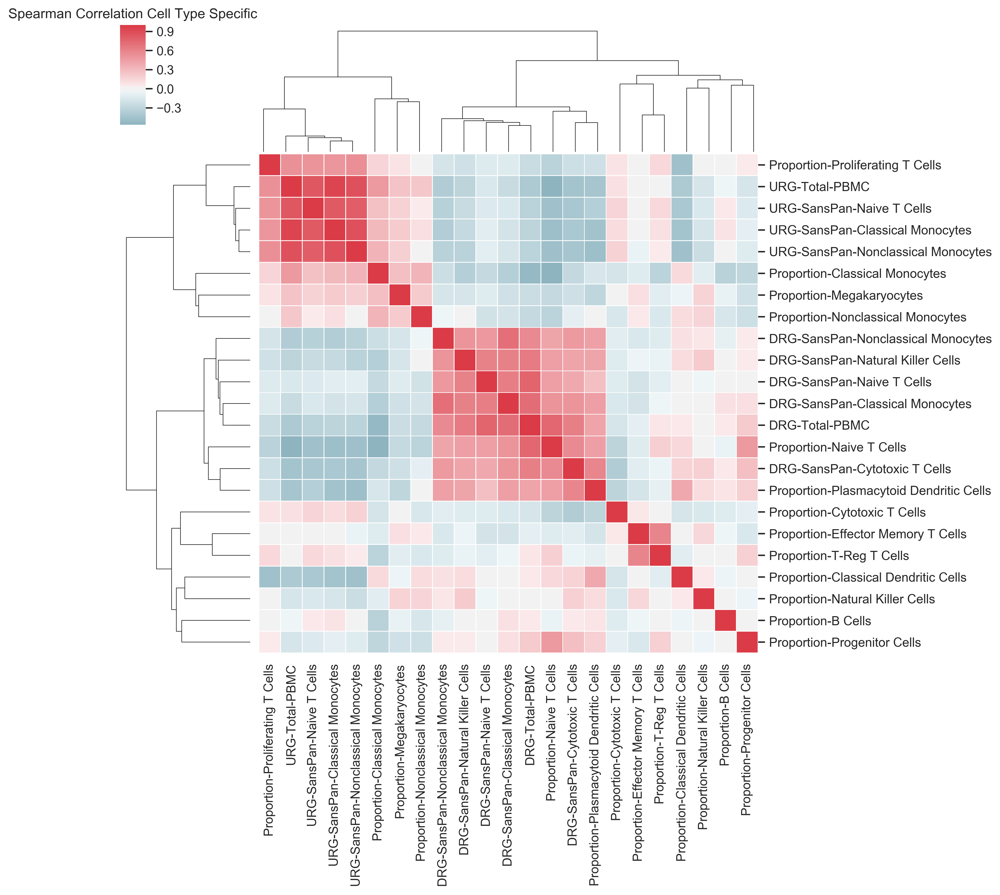

In [131]:
SansPan_corr = SansPan.corr(method='spearman')
plot_clustermap(SansPan_corr, title='Spearman Correlation Cell Type Specific', fontscale=1, save=True)


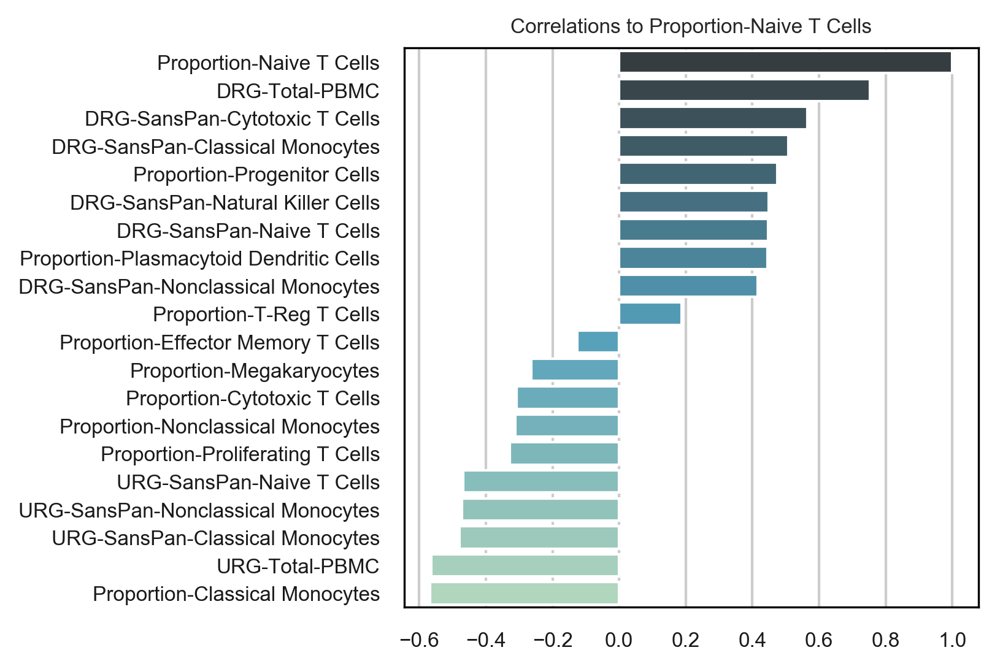

In [227]:
plot_barplot(SansPan_corr, label='Proportion-Naive T Cells')

                               OLS Regression Results                               
Dep. Variable:     Proportion-Naive T Cells   R-squared:                       0.192
Model:                                  OLS   Adj. R-squared:                  0.188
Method:                       Least Squares   F-statistic:                     45.77
Date:                      Sat, 21 Mar 2020   Prob (F-statistic):           1.57e-10
Time:                              15:16:18   Log-Likelihood:                -730.26
No. Observations:                       194   AIC:                             1465.
Df Residuals:                           192   BIC:                             1471.
Df Model:                                 1                                         
Covariance Type:                  nonrobust                                         
                                      coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------

/opt/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2495: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


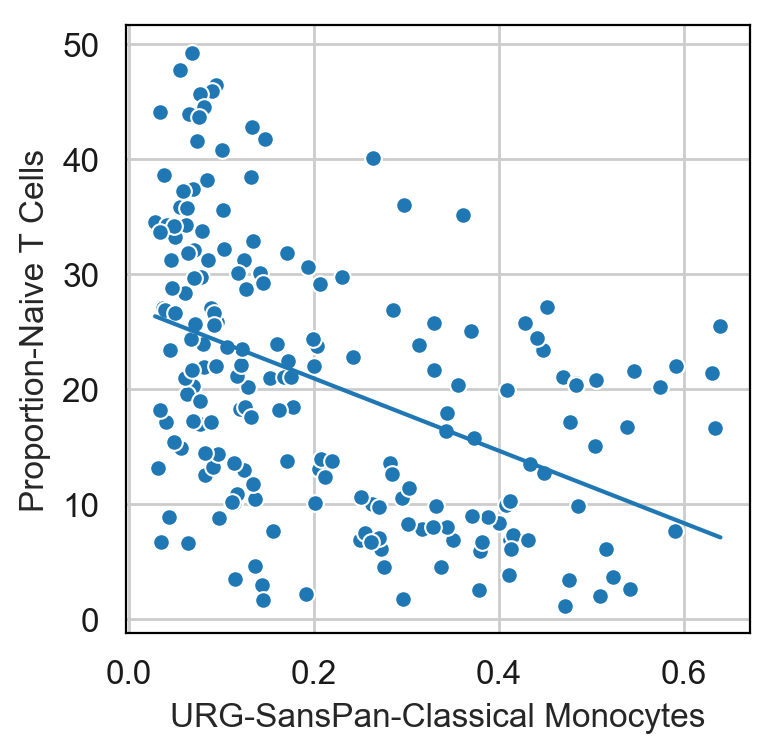

In [251]:
results = quick_OLS(SansPan['URG-SansPan-Classical Monocytes'], SansPan['Proportion-Naive T Cells'], show_summary=True)


# CD69 and SIP1

/opt/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2495: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


                               OLS Regression Results                               
Dep. Variable:     Proportion-Naive T Cells   R-squared:                       0.103
Model:                                  OLS   Adj. R-squared:                  0.098
Method:                       Least Squares   F-statistic:                     21.93
Date:                      Sat, 21 Mar 2020   Prob (F-statistic):           5.34e-06
Time:                              15:24:41   Log-Likelihood:                -740.50
No. Observations:                       194   AIC:                             1485.
Df Residuals:                           192   BIC:                             1492.
Df Model:                                 1                                         
Covariance Type:                  nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------

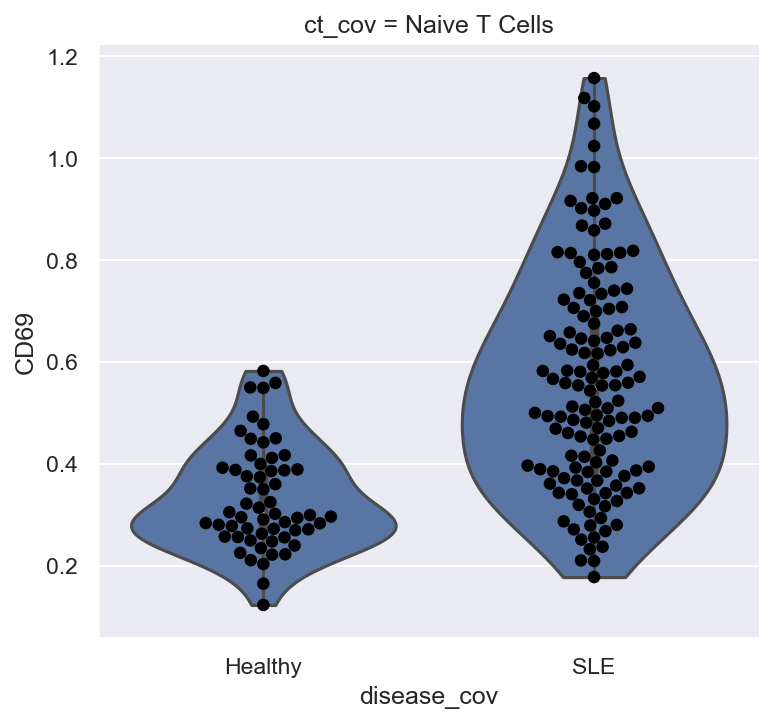

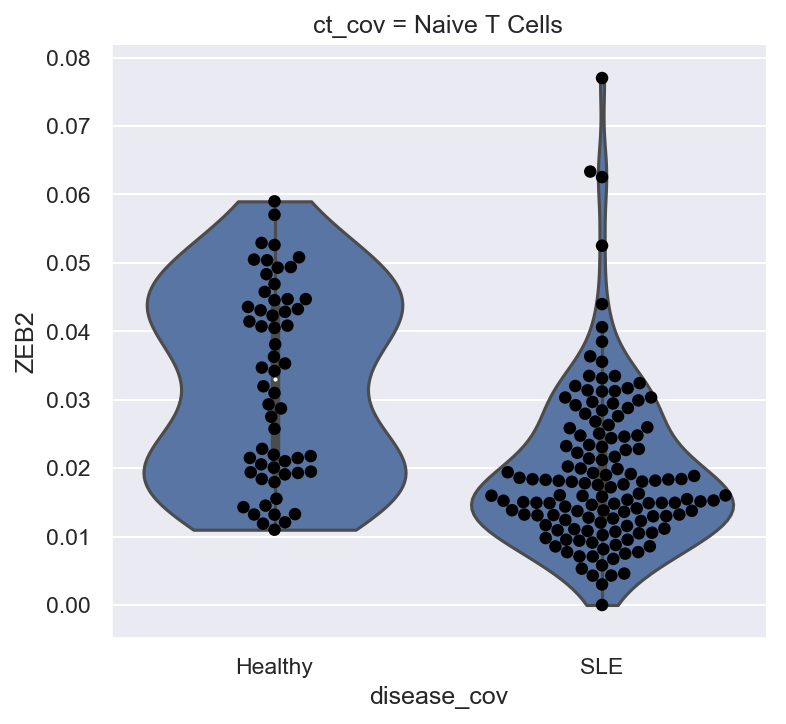

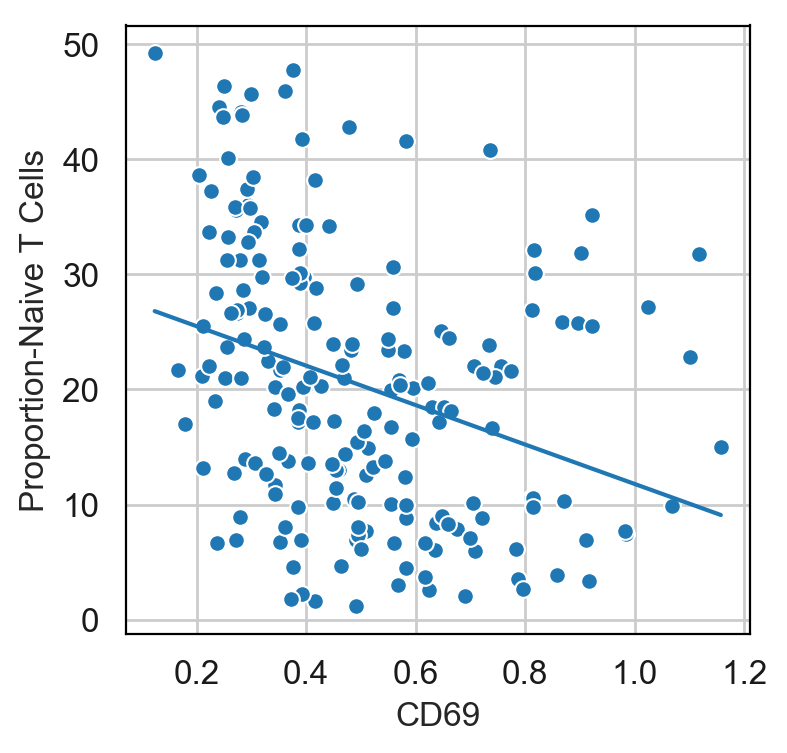

In [261]:
CD69 = plot_gene_expression(adata, celltypes=['Naive T Cells'], gene='CD69', normalize=False)
SIP1 = plot_gene_expression(adata, celltypes=['Naive T Cells'], gene='ZEB2', normalize=False)
SansPan2 = add_gene_covar(SansPan, CD69, 'CD69')
SansPan2 = add_gene_covar(SansPan2, SIP1, 'ZEB2')
results = quick_OLS(SansPan2['CD69'], SansPan2['Proportion-Naive T Cells'], show_summary=True)


# Compare Interferon signatures with CD69 expression

                            OLS Regression Results                            
Dep. Variable:                   CD69   R-squared:                       0.295
Model:                            OLS   Adj. R-squared:                  0.292
Method:                 Least Squares   F-statistic:                     80.45
Date:                Sat, 21 Mar 2020   Prob (F-statistic):           2.69e-16
Time:                        15:23:06   Log-Likelihood:                 55.020
No. Observations:                 194   AIC:                            -106.0
Df Residuals:                     192   BIC:                            -99.51
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
const              0.3556      0.020     17.

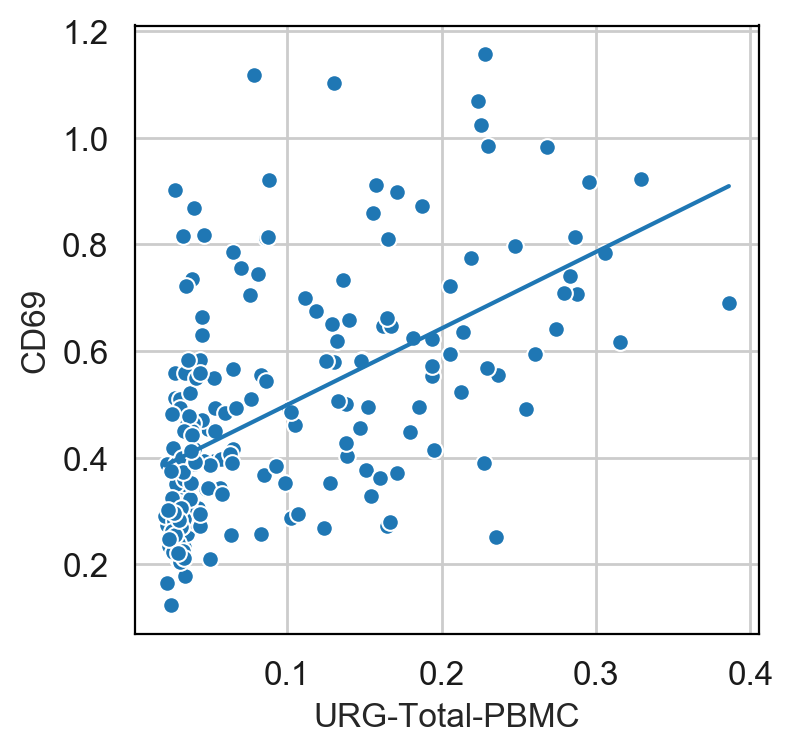

In [259]:
results = quick_OLS(SansPan2['URG-Total-PBMC'], SansPan2['CD69'], show_summary=True)

                            OLS Regression Results                            
Dep. Variable:                   CD69   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.267
Method:                 Least Squares   F-statistic:                     71.17
Date:                Sat, 21 Mar 2020   Prob (F-statistic):           7.81e-15
Time:                        15:23:03   Log-Likelihood:                 51.658
No. Observations:                 194   AIC:                            -99.32
Df Residuals:                     192   BIC:                            -92.78
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                                      coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
const     

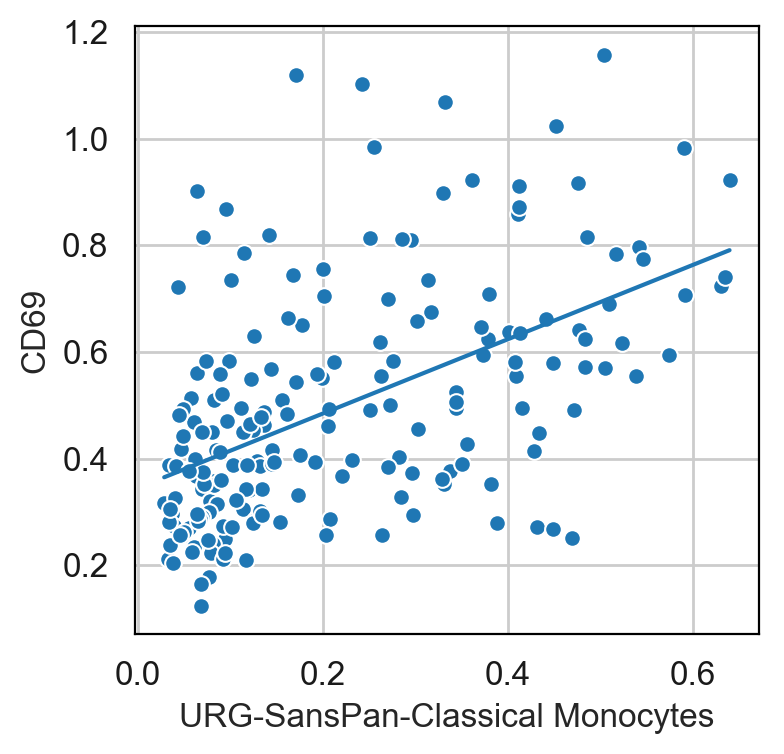

In [258]:
results = quick_OLS(SansPan2['URG-SansPan-Classical Monocytes'], SansPan2['CD69'], show_summary=True)

# Compare r-sqaured with other signatures

In [240]:
SansPan2 = SansPan2.dropna()
keys = list(SansPan2.columns)
R2 = {}
for ii in range(len(keys)):
    results = quick_OLS(SansPan2[keys[ii]].values, SansPan2['CD69'].values, show_summary=False)
    R2[keys[ii]] = results.rsquared
R2 = np.flipud(sorted(R2.items(), key=lambda x: x[1]))
print(R2[:5])

[['CD69' '1.0']
 ['URG-Total-PBMC' '0.28650301298810144']
 ['URG-SansPan-Classical Monocytes' '0.25327706281626183']
 ['URG-SansPan-Nonclassical Monocytes' '0.24063832144804043']
 ['URG-SansPan-Naive T Cells' '0.18645281585422457']]


# Compare with clinical variables

In [262]:
SansPan = build_covar(SansPan,  keys = ['SLAQ score', 'SLIC score', 'acrcsum', 'sledaiscore'])

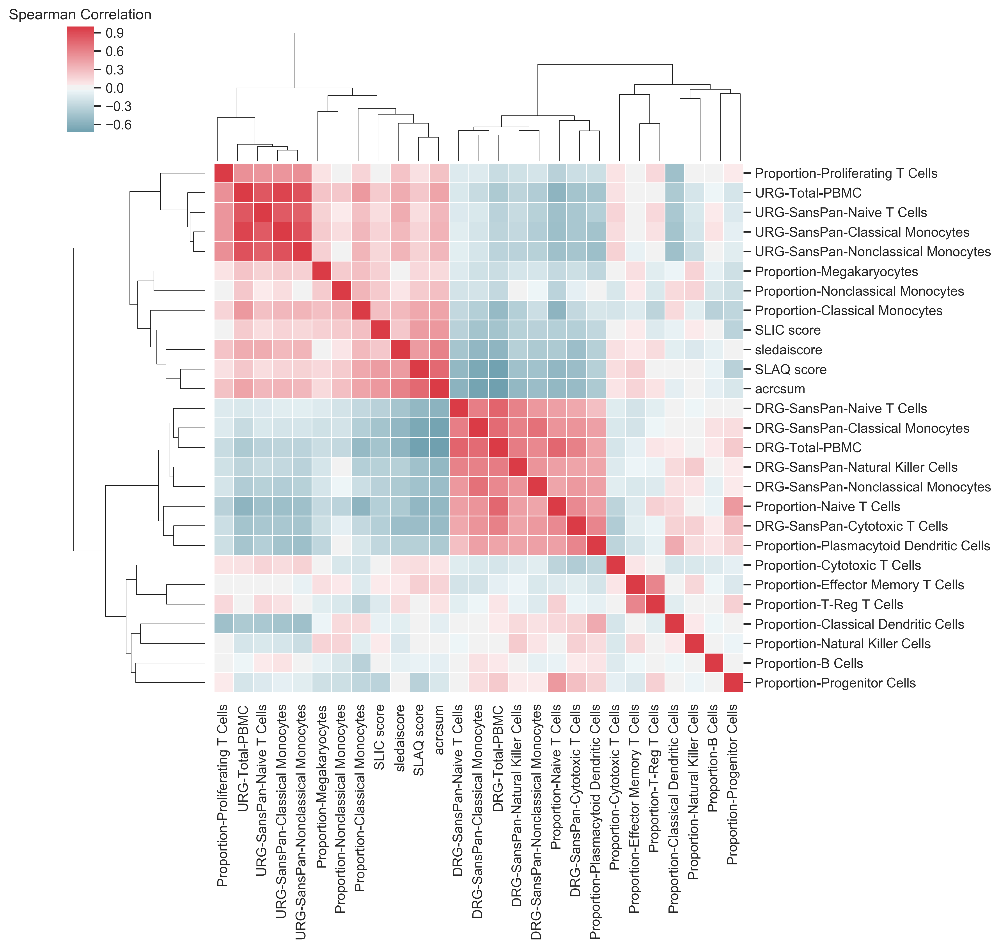

In [263]:
SansPan_corr = SansPan.corr(method='spearman')
plot_clustermap(SansPan_corr, title='Spearman Correlation', fontscale=1, save=True)

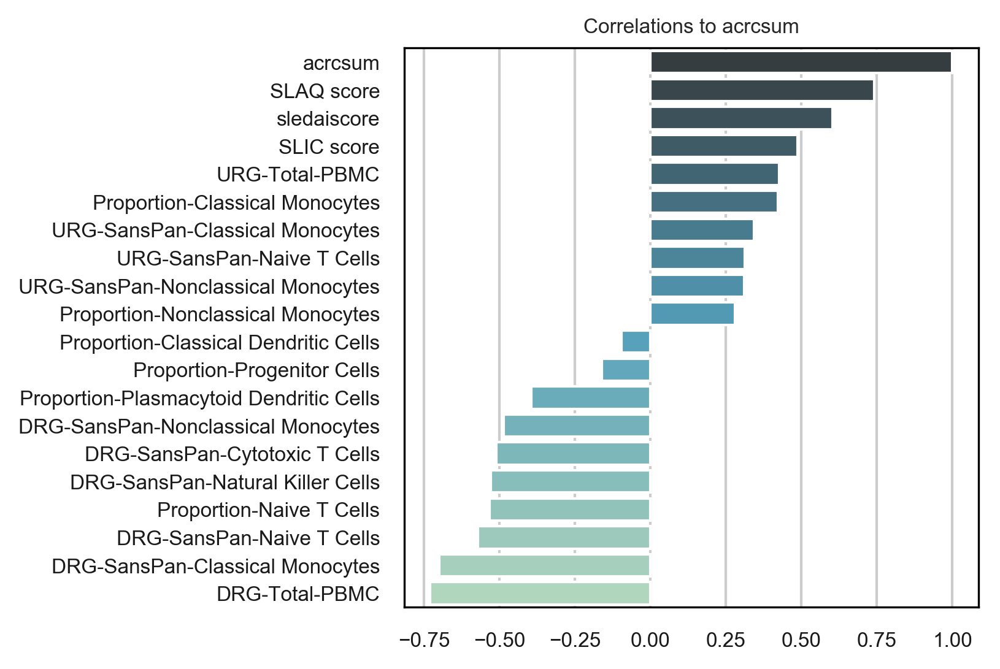

In [264]:
plot_barplot(SansPan_corr, label='acrcsum')

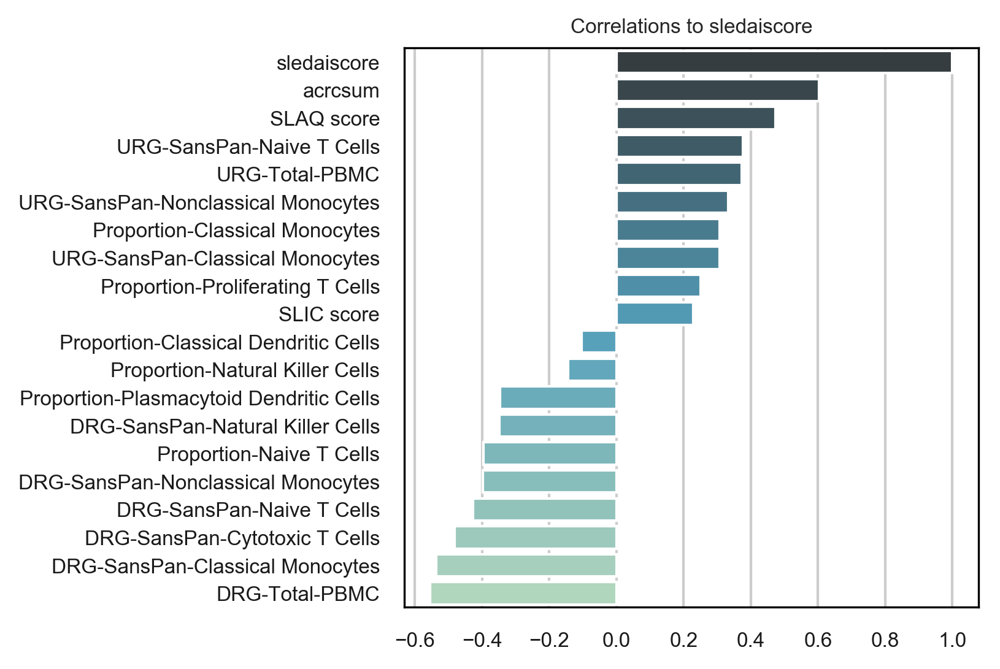

In [274]:
plot_barplot(SansPan_corr, label='sledaiscore')

# RNU11

/opt/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2495: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


                            OLS Regression Results                            
Dep. Variable:                acrcsum   R-squared:                       0.333
Model:                            OLS   Adj. R-squared:                  0.330
Method:                 Least Squares   F-statistic:                     96.07
Date:                Sat, 21 Mar 2020   Prob (F-statistic):           1.20e-18
Time:                        15:42:22   Log-Likelihood:                -437.31
No. Observations:                 194   AIC:                             878.6
Df Residuals:                     192   BIC:                             885.2
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          4.6176      0.215     21.448      0.0

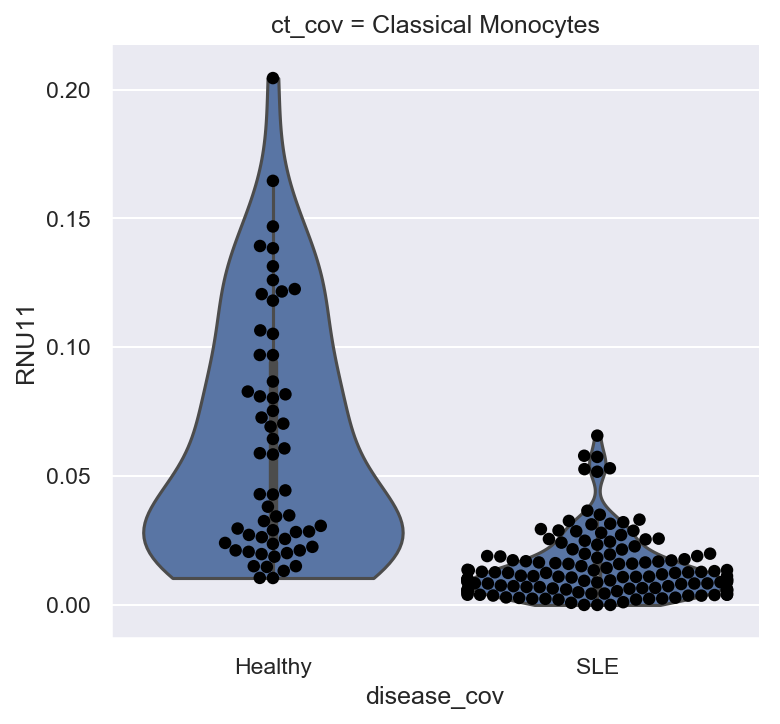

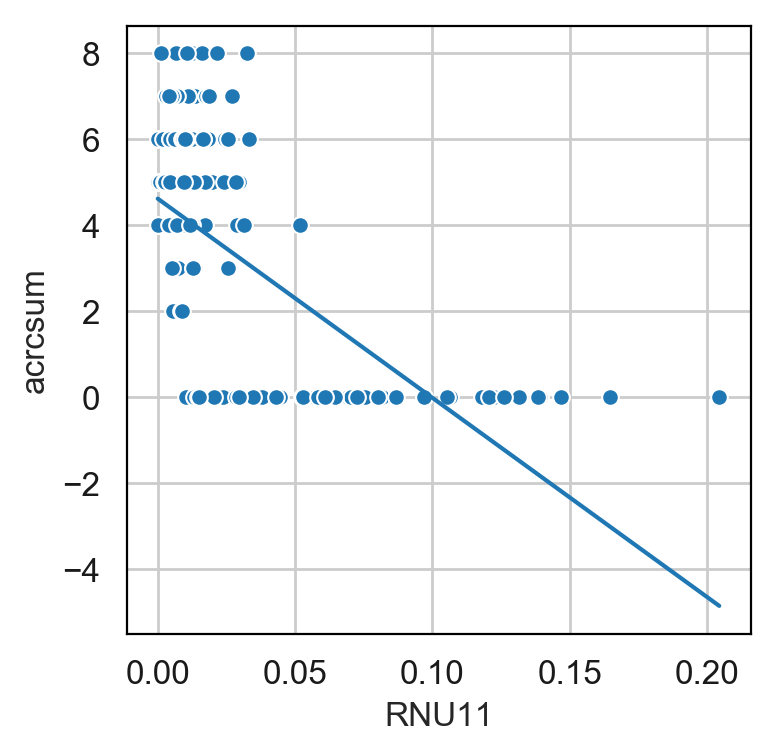

In [291]:
RNU11 = plot_gene_expression(adata, celltypes=['Classical Monocytes'], gene='RNU11', normalize=False)
SansPan2 = add_gene_covar(SansPan, RNU11, 'RNU11')
results = quick_OLS(SansPan2['RNU11'], SansPan['acrcsum'], show_summary=True)


# Logistic regression on clinical variables

In [991]:
def logistic_regression(corr_matrix, clincal_var, n_boot):
    # Remove people with no clinical variables
    corr_matrix_logreg = corr_matrix[~corr_matrix.transpose().columns.isin(['FLARE002', 'FLARE004', 'FLARE005', 'FLARE006', 
                                                                         'FLARE007', 'FLARE009', 'FLARE011', 'FLARE013', 
                                                                         'FLARE014', 'FLARE015', 'FLARE016', 'FLARE017', 
                                                                         'FLARE018', 'FLARE019', 'FLARE020'])]
    # Add clinical outcome
    corr_matrix_logreg = build_covar(corr_matrix_logreg, keys = [clincal_var])
    # Drop NaN from dataframe
    corr_matrix_logreg = corr_matrix_logreg.dropna()
    # Dependent variable
    Y = corr_matrix_logreg[clincal_var].values.ravel()
    # Remove dependent variable from variables
    corr_matrix_logreg = corr_matrix_logreg.drop(clincal_var, axis=1)
    # observations x features
    X = corr_matrix_logreg.as_matrix()
    # Variables of interest
    VOIs = {}; ROC_AUC = {}; FPR = {}; TPR = {};
    for ii in range(n_boot):
        # Split data
        X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2)

        # Over sample cases and undersample controls to improve classification
        os = SMOTE(random_state=0)
        os_data_X, os_data_y = os.fit_sample(X_train, y_train)
        
        # Setup logistic regression
        logreg = LogisticRegression(max_iter=5000, penalty='elasticnet', solver='saga', l1_ratio=0.5)
        # Find optimal parameters
        rfe = RFE(logreg, 3)
        #rfe = SelectFromModel(logreg, threshold='10*mean')
        #rfe = SelectFromModel(logreg)
        rfe = rfe.fit(os_data_X, os_data_y)
        ind_var = np.asarray(list(corr_matrix_logreg.columns))

        # Preserve optimate features only from train and test set
        os_data_X = os_data_X[:, rfe.get_support()]
        X_test = X_test[:, rfe.get_support()]
        # Fit Logistic regression
        logreg = LogisticRegression(max_iter=5000, penalty='elasticnet', solver='saga', l1_ratio=0.5)
        logreg.fit(os_data_X, os_data_y)
        VOIs[ii] = list(ind_var[rfe.get_support()])
        # Perform prediction
        y_pred = logreg.predict(X_test)

        # ROC curve
        logit_roc_auc = roc_auc_score(y_test, logreg.predict(X_test))
        ROC_AUC[ii] = logit_roc_auc 
        # Collect True and False Positive rates
        fpr, tpr, thresholds = roc_curve(y_test, logreg.predict_proba(X_test)[:,1], drop_intermediate=False)
        FPR[ii] = fpr
        TPR[ii] = tpr
    return VOIs, ROC_AUC, FPR, TPR


In [837]:
def plot_ROC(ROC_AUC, FPR, TPR):
    sc.settings.set_figure_params(dpi=100, dpi_save=200, format='png', frameon=False, transparent=True, fontsize=12)
    plt.figure()
    FPR_mean = pd.DataFrame(FPR).mean(axis=1).values; TPR_mean = pd.DataFrame(TPR).mean(axis=1).values
    lower95TPR = TPR_mean-(pd.DataFrame(TPR).std(axis=1).values*1.96)
    upper95TPR = TPR_mean+(pd.DataFrame(TPR).std(axis=1).values*1.96)
    plt.plot(FPR_mean, TPR_mean, 'b-', linewidth=2)
    plt.fill_between(FPR_mean, lower95TPR, upper95TPR, color='b', alpha=.2)
    plt.plot([0, 1], [0, 1],'r--')
    plt.xlim([-0.02, 1.0])
    plt.ylim([0.0, 1.02])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC AUC average: {0}, median: {1}, bootstraps: {2}'.format(round(np.mean(list(ROC_AUC.values())),3), round(np.median(list(ROC_AUC.values())),3), len(ROC_AUC)))
    plt.show()
    
def show_VOI(VOIs):
    sc.settings.set_figure_params(dpi=100, dpi_save=200, format='png', frameon=False, transparent=True, fontsize=5)
    from palettable.colorbrewer.qualitative import Pastel1_7
    flat_list = [item for sublist in list(VOIs.values()) for item in sublist]
    unique_VOIs = np.unique(flat_list); VOI_count = {}
    for ii in range(len(unique_VOIs)):
        VOI_count[unique_VOIs[ii]] = np.sum(np.asarray(flat_list) == unique_VOIs[ii])
    def my_autopct(pct):
        return ('%1.1f%%' % pct) if pct > 5 else ''
    labels = np.asarray(list(VOI_count.keys()))
    labels[list(VOI_count.values()) < (np.sum(list(VOI_count.values()))*0.05)] = ''
    my_circle=plt.Circle( (0,0), 0.7, color='white')
    plt.pie(list(VOI_count.values()), labels=labels, colors=Pastel1_7.hex_colors, textprops={'fontsize': 7}, autopct=my_autopct)
    p=plt.gcf()
    p.gca().add_artist(my_circle)
    plt.show()
    
    

# Remove Clinical Variables from dataframe

In [800]:
def remove_clinical(dataframe):
    clinical = pd.read_csv('lupus.sledai.txt', sep='\t')
    variables = list(clincal.columns)
    for var in variables:
        try:
            dataframe = dataframe.drop(var, axis=1)
        except:
            continue
    return dataframe

In [1240]:
SansPan = remove_clinical(SansPan)
SansPan_cases = SansPan[SansPan.transpose().columns.isin(np.unique(adata.obs['ind_cov'][adata.obs['SLE status']=='SLE'].tolist()))]

In [839]:
# Cases only
corr_matrix_cases = corr_matrix[corr_matrix.transpose().columns.isin(np.unique(adata.obs['ind_cov'][adata.obs['SLE status']=='SLE'].tolist()))]
            

# Arthritis

In [938]:
%%capture
VOIs, ROC_AUC, FPR, TPR = logistic_regression(corr_matrix, clincal_var='acrarthritisc', n_boot=100)

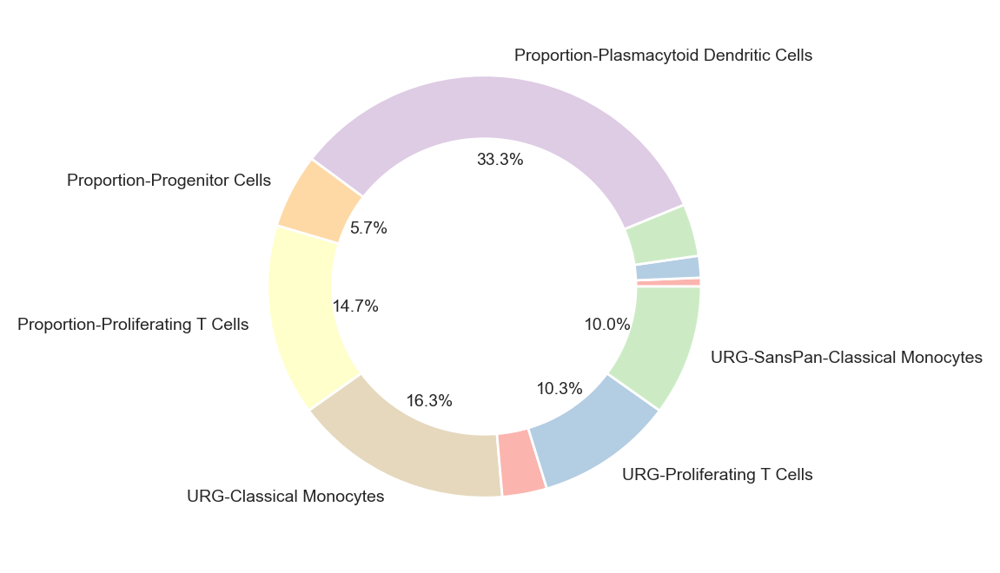

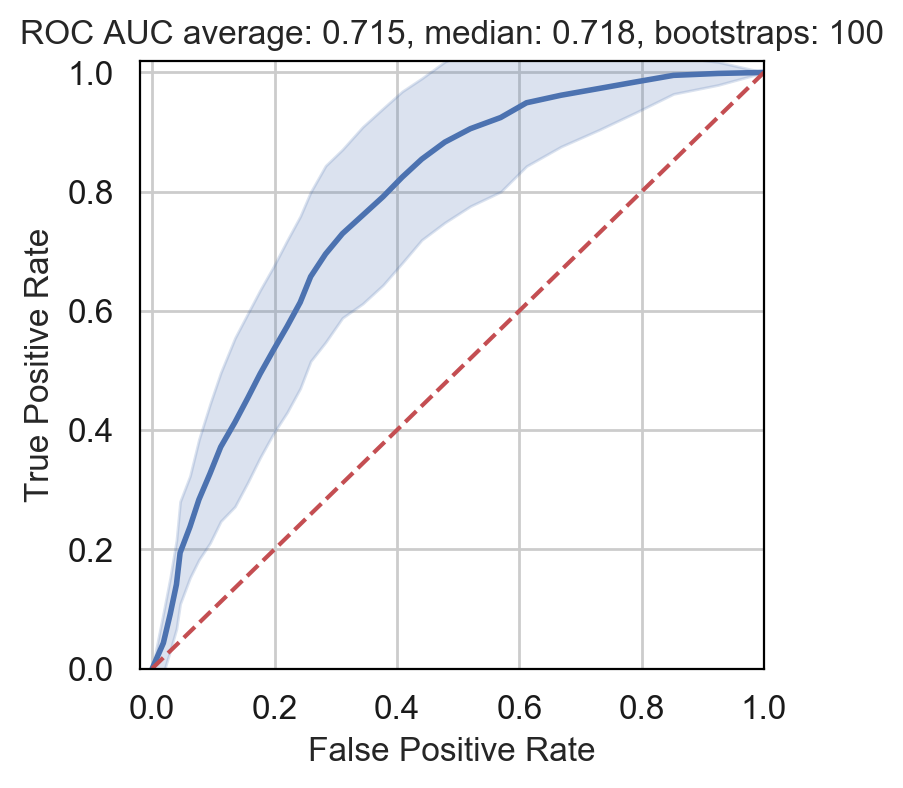

In [939]:
show_VOI(VOIs)
plot_ROC(ROC_AUC, FPR, TPR)

# Lupus Nephritis

In [940]:
%%capture
VOIs, ROC_AUC, FPR, TPR = logistic_regression(corr_matrix, clincal_var='acrlupneph', n_boot=100)

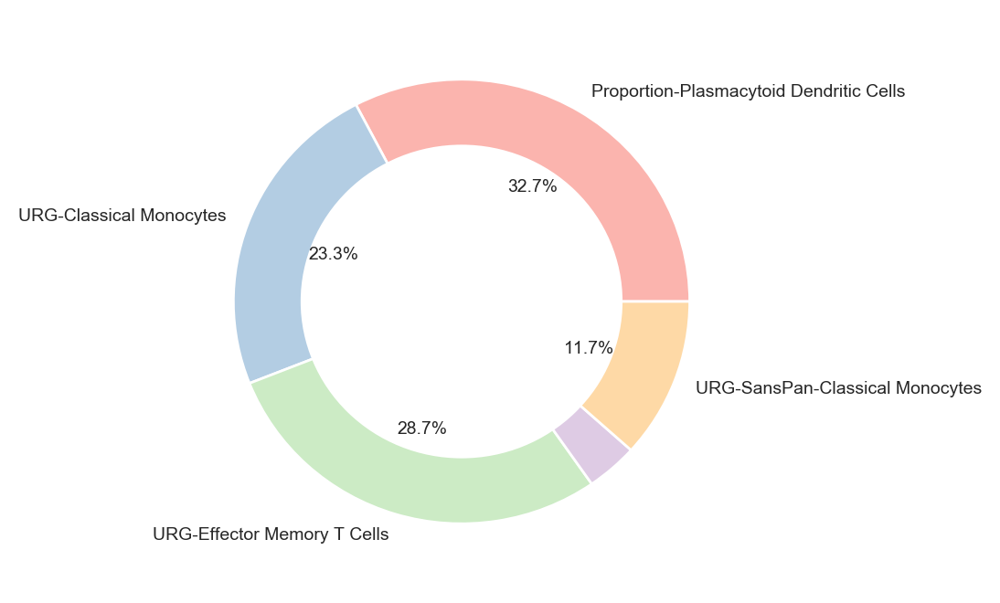

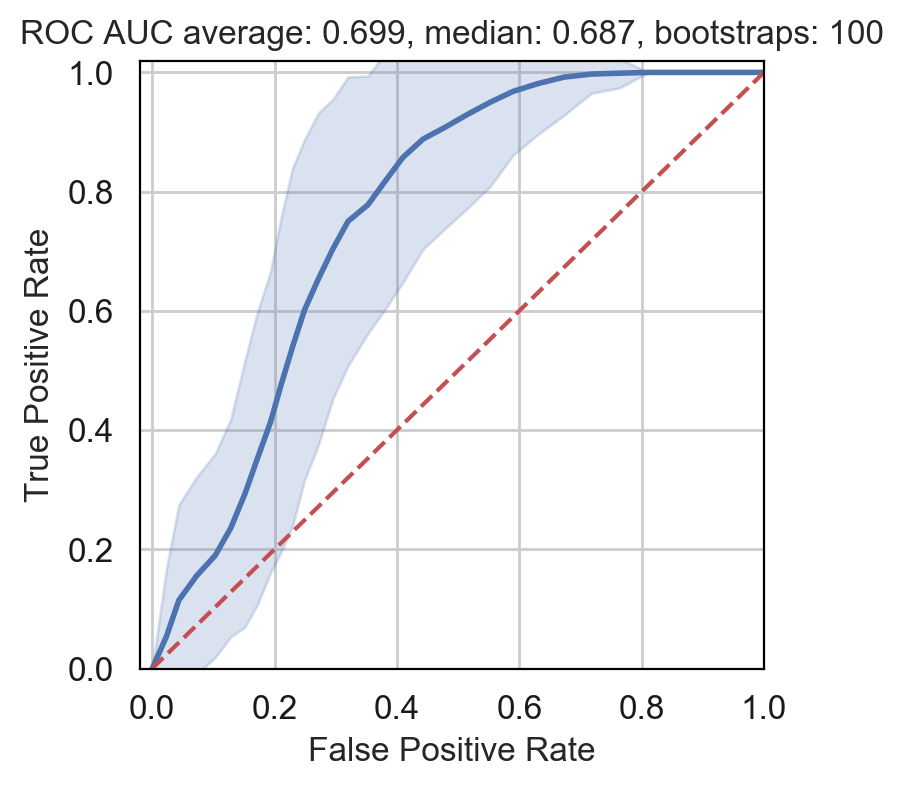

In [941]:
show_VOI(VOIs)
plot_ROC(ROC_AUC, FPR, TPR)

# Any Renal Involvement

In [942]:
%%capture
VOIs, ROC_AUC, FPR, TPR = logistic_regression(corr_matrix, clincal_var='acrrenalc', n_boot=100)

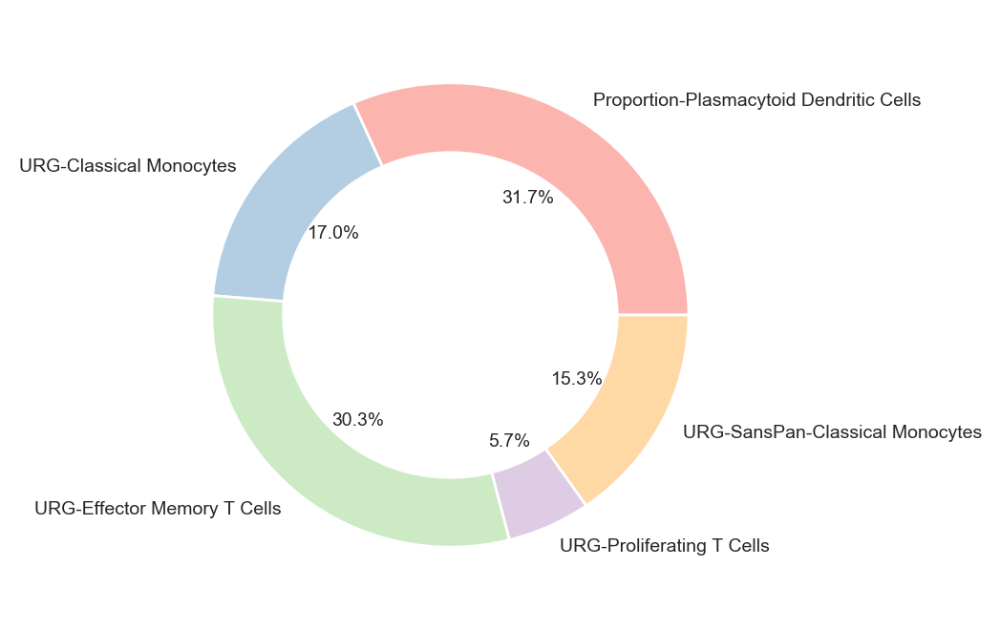

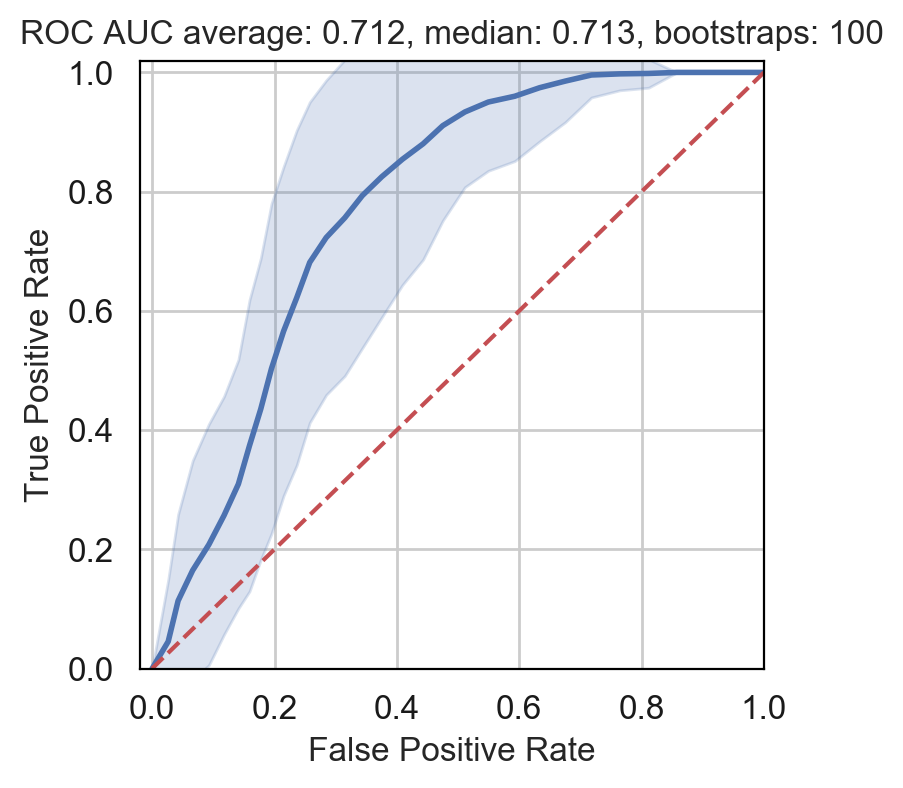

In [943]:
show_VOI(VOIs)
plot_ROC(ROC_AUC, FPR, TPR)

# anti-ANA

In [1247]:
%%capture
VOIs, ROC_AUC, FPR, TPR = logistic_regression(SansPan, clincal_var='acranac', n_boot=100)

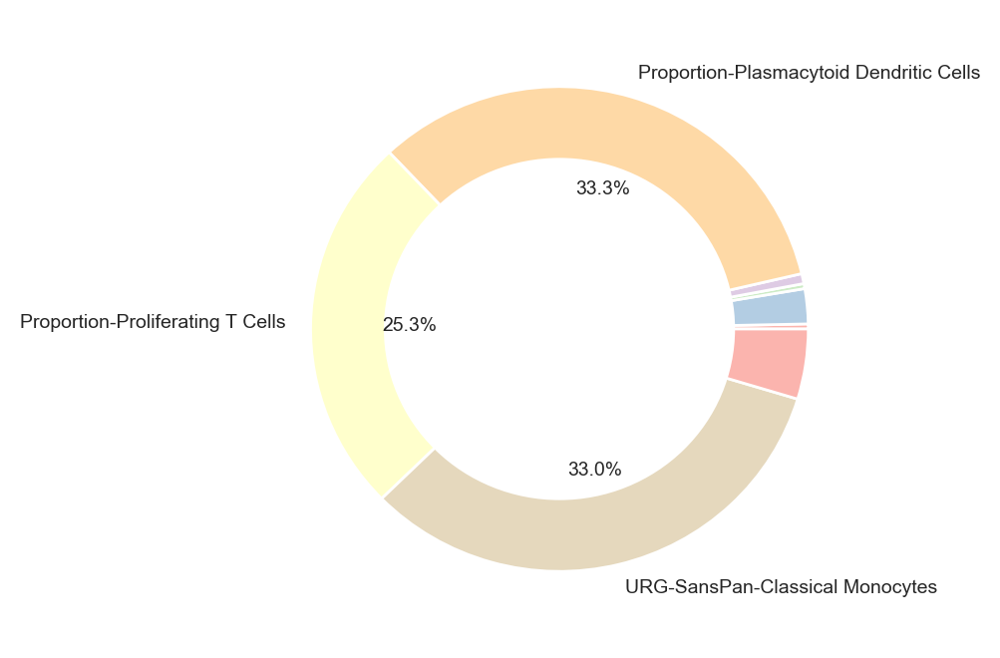

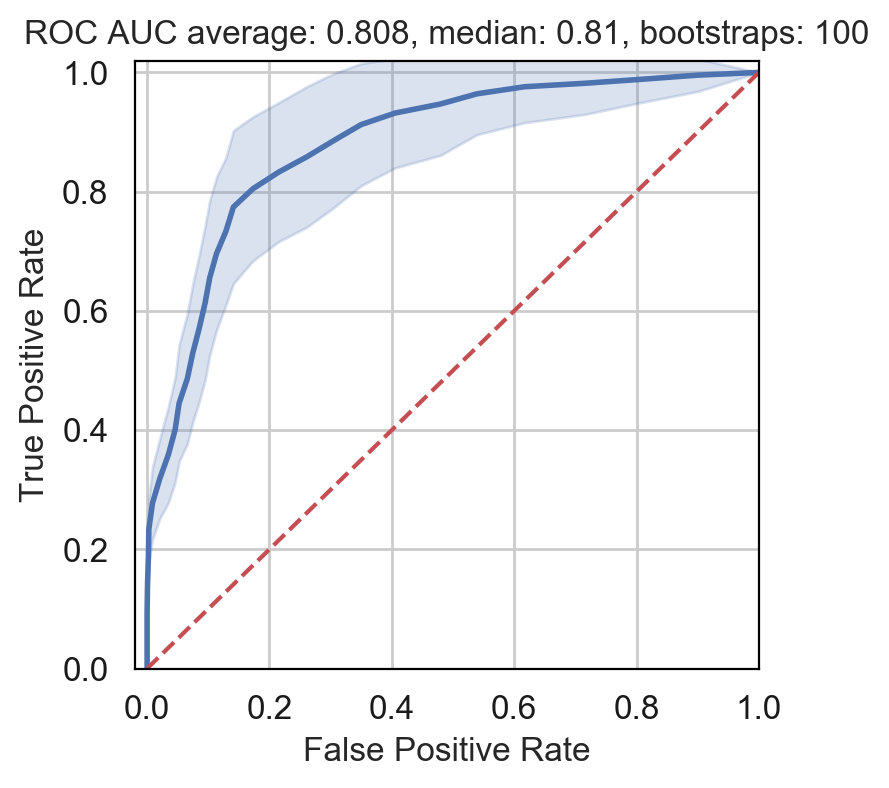

In [1248]:
show_VOI(VOIs)
plot_ROC(ROC_AUC, FPR, TPR)

# anti-Smith

In [946]:
%%capture
VOIs, ROC_AUC, FPR, TPR = logistic_regression(corr_matrix, clincal_var='acrantismith', n_boot=100)

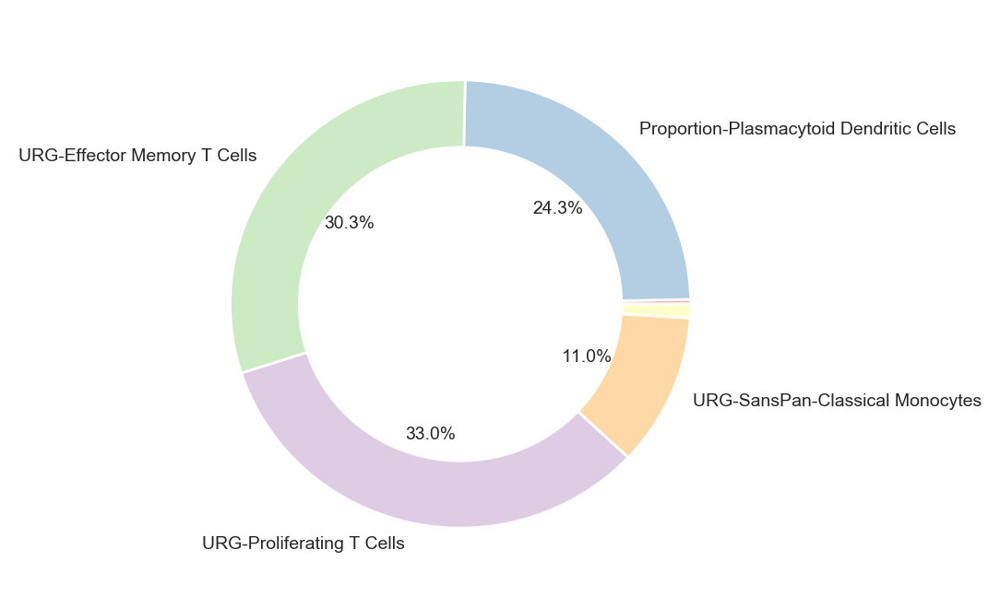

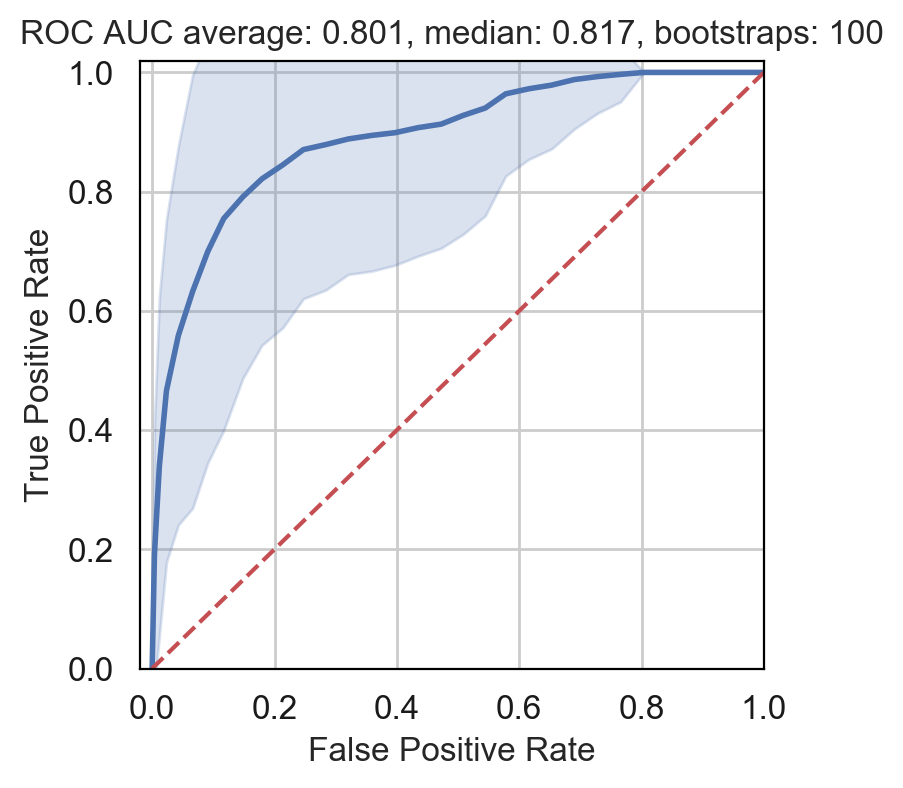

In [947]:
show_VOI(VOIs)
plot_ROC(ROC_AUC, FPR, TPR)

# anti-Smith Cases Only

In [992]:
%%capture
VOIs, ROC_AUC, FPR, TPR = logistic_regression(corr_matrix_cases, clincal_var='acrantismith', n_boot=500)

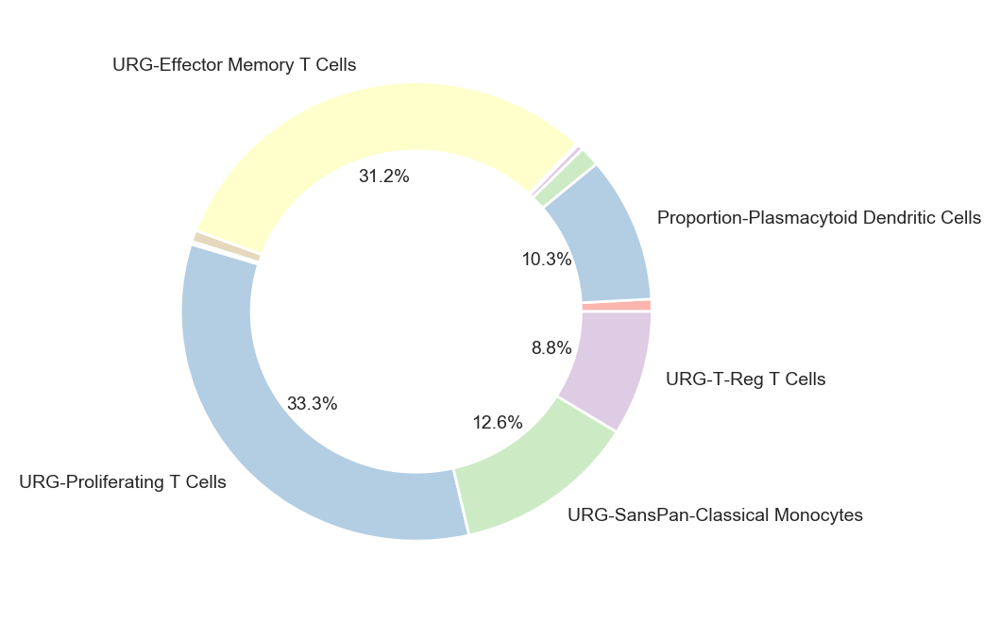

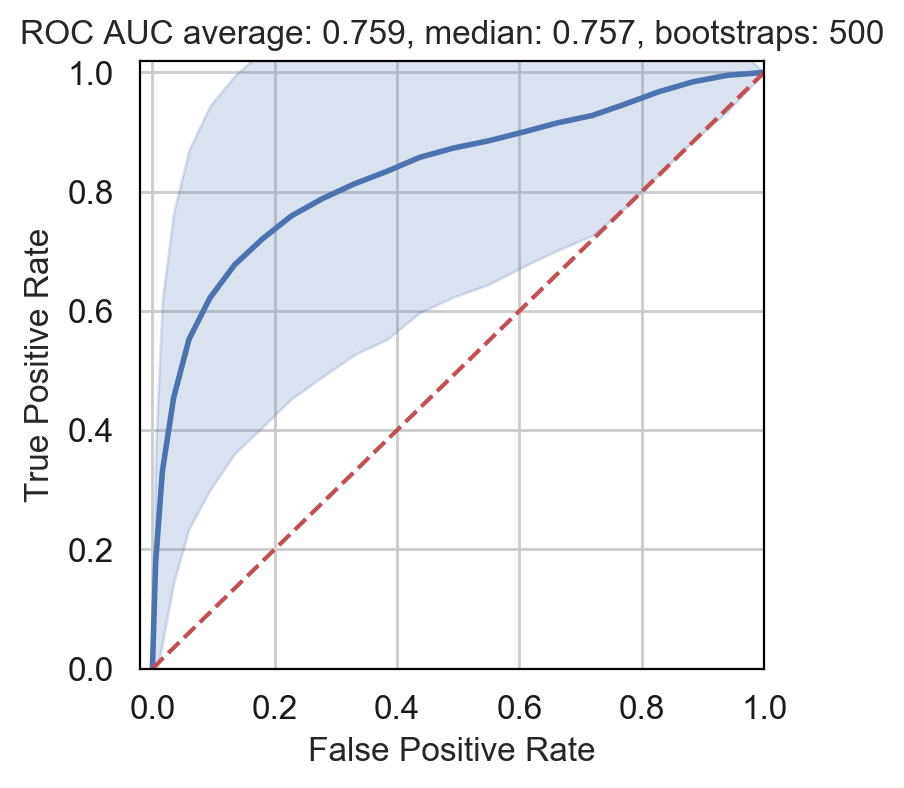

In [993]:
show_VOI(VOIs)
plot_ROC(ROC_AUC, FPR, TPR)

# anti-dsDNA

In [950]:
%%capture
VOIs, ROC_AUC, FPR, TPR = logistic_regression(corr_matrix, clincal_var='acrantidsdna', n_boot=100)

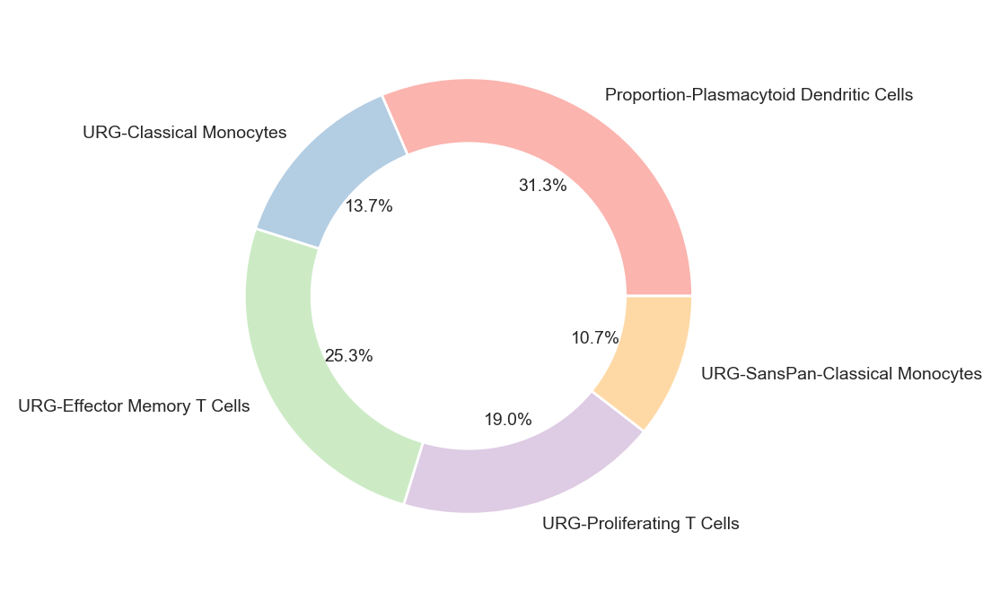

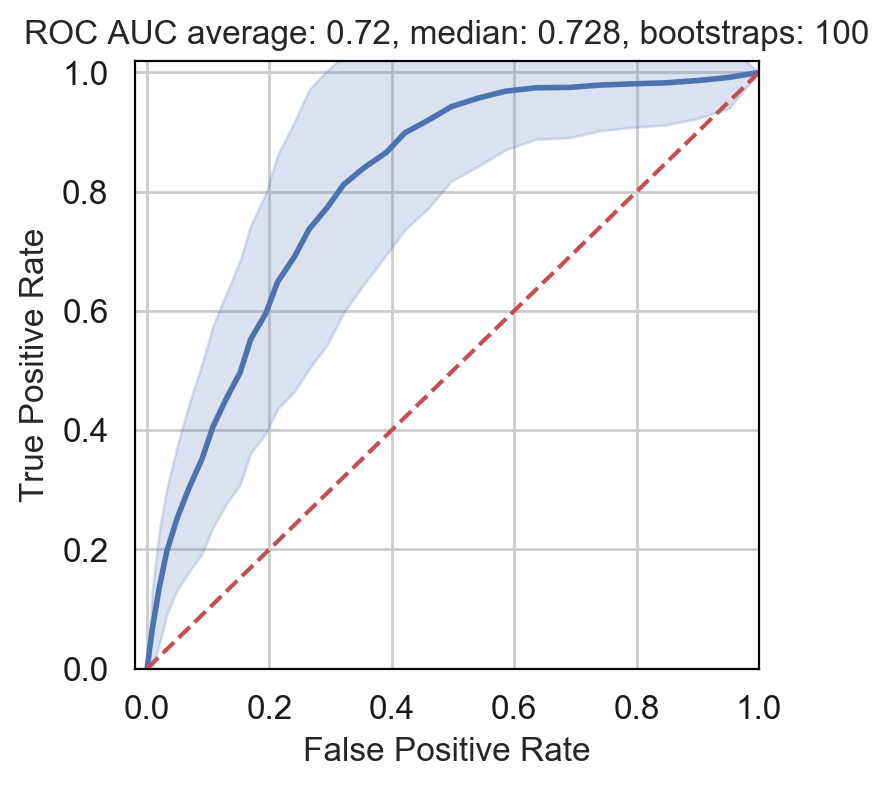

In [951]:
show_VOI(VOIs)
plot_ROC(ROC_AUC, FPR, TPR)

# Malar rash

In [952]:
%%capture
VOIs, ROC_AUC, FPR, TPR = logistic_regression(corr_matrix, clincal_var='acrmalar', n_boot=100)

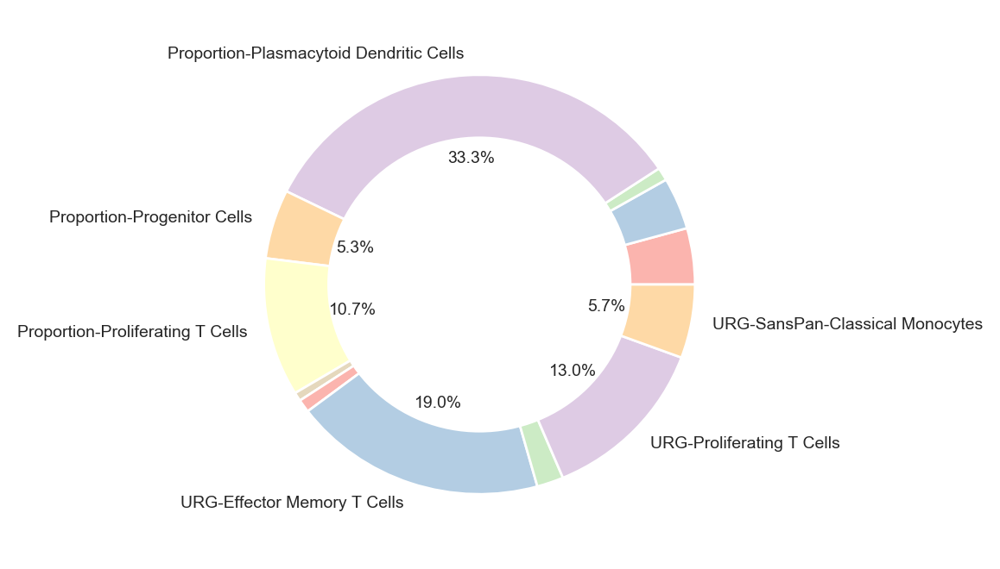

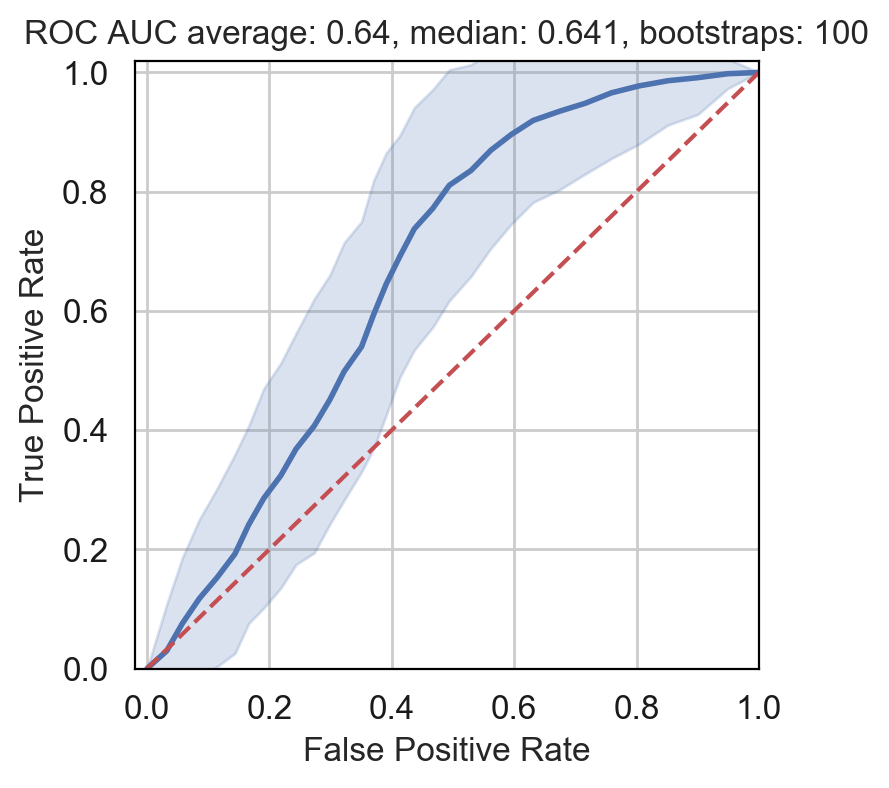

In [953]:
show_VOI(VOIs)
plot_ROC(ROC_AUC, FPR, TPR)

# Mucosal ulcers

In [954]:
%%capture
VOIs, ROC_AUC, FPR, TPR = logistic_regression(corr_matrix, clincal_var='acrmuculcers', n_boot=100)

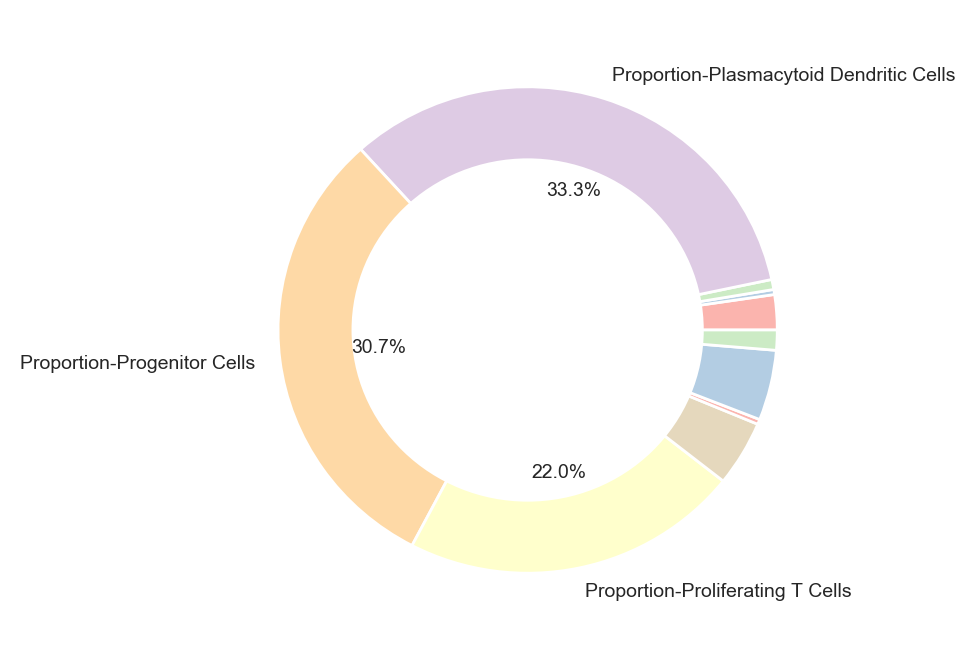

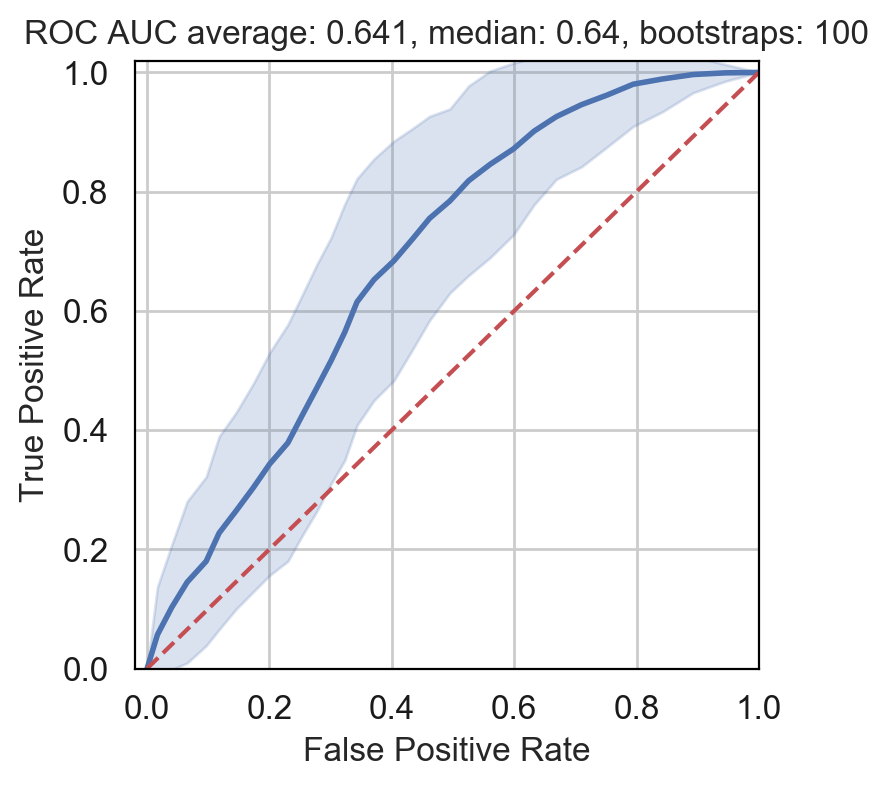

In [955]:
show_VOI(VOIs)
plot_ROC(ROC_AUC, FPR, TPR)

# Serositis

In [958]:
%%capture
VOIs, ROC_AUC, FPR, TPR = logistic_regression(corr_matrix, clincal_var='acrserositisc', n_boot=100)

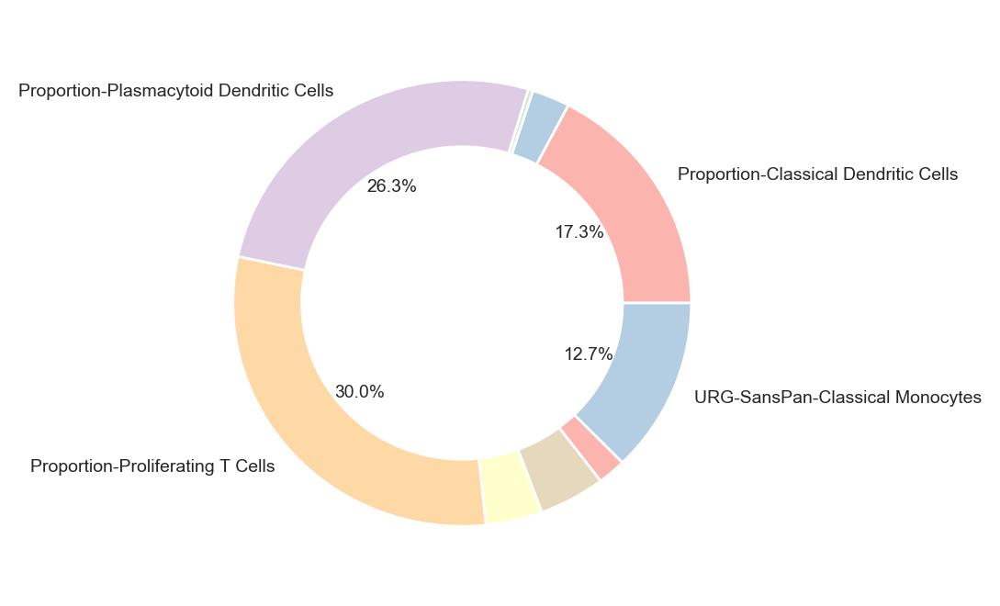

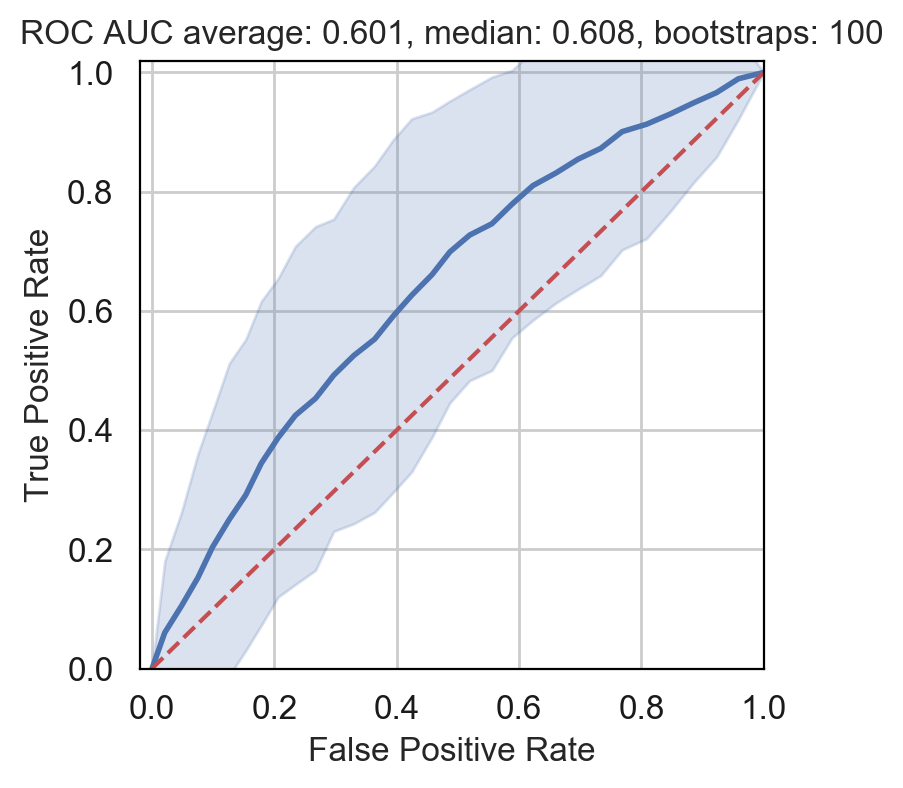

In [959]:
show_VOI(VOIs)
plot_ROC(ROC_AUC, FPR, TPR)
# Why does RP4. Do cases analysis

# Photosensitivity

In [960]:
%%capture
VOIs, ROC_AUC, FPR, TPR = logistic_regression(corr_matrix, clincal_var='acrphotosensitiv', n_boot=100)

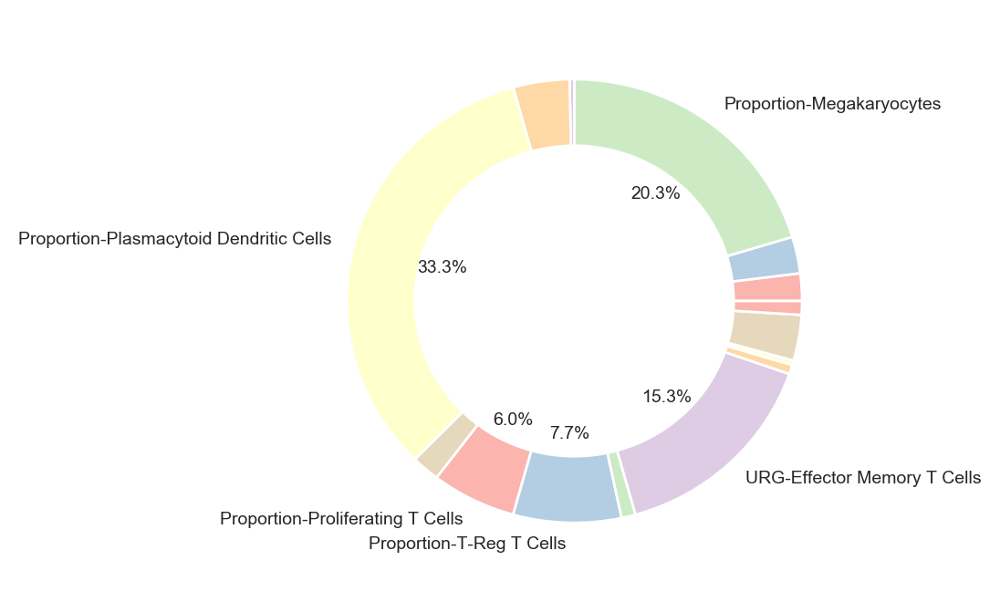

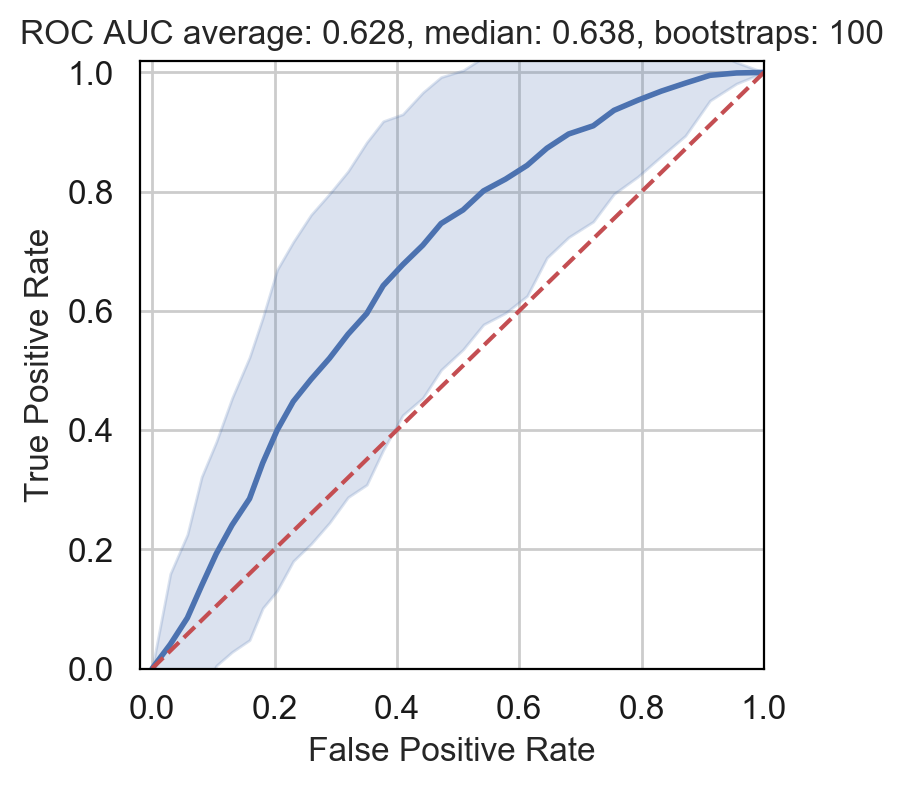

In [961]:
show_VOI(VOIs)
plot_ROC(ROC_AUC, FPR, TPR)

# anti-phospholipid antigen

In [962]:
%%capture
VOIs, ROC_AUC, FPR, TPR = logistic_regression(corr_matrix, clincal_var='acrapla', n_boot=100)

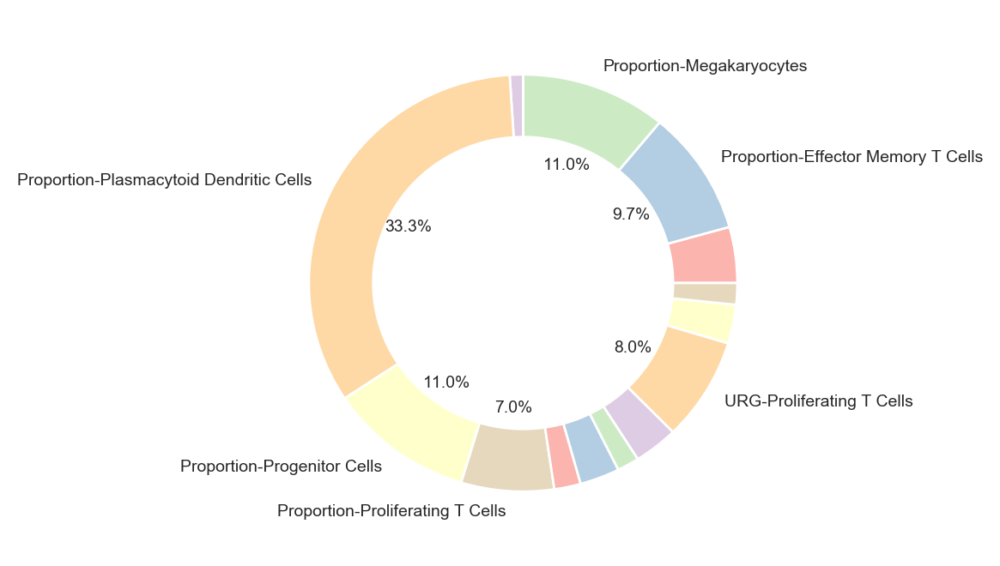

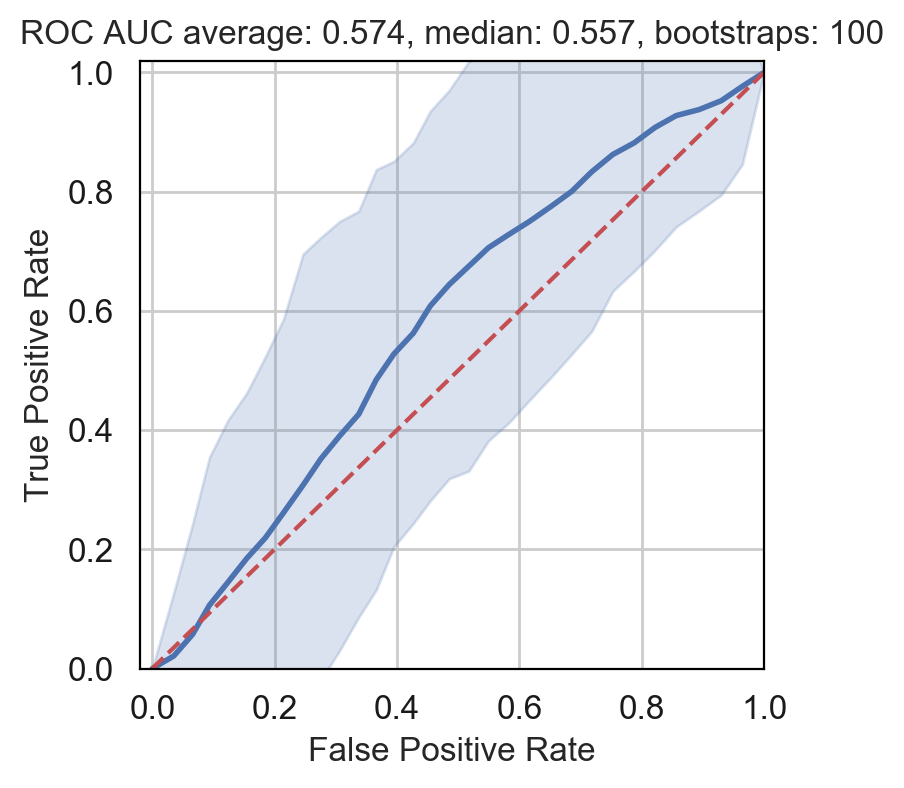

In [963]:
show_VOI(VOIs)
plot_ROC(ROC_AUC, FPR, TPR)

# Lymphopenia

In [964]:
%%capture
VOIs, ROC_AUC, FPR, TPR, = logistic_regression(corr_matrix, clincal_var='acrlymphopenia', n_boot=100)

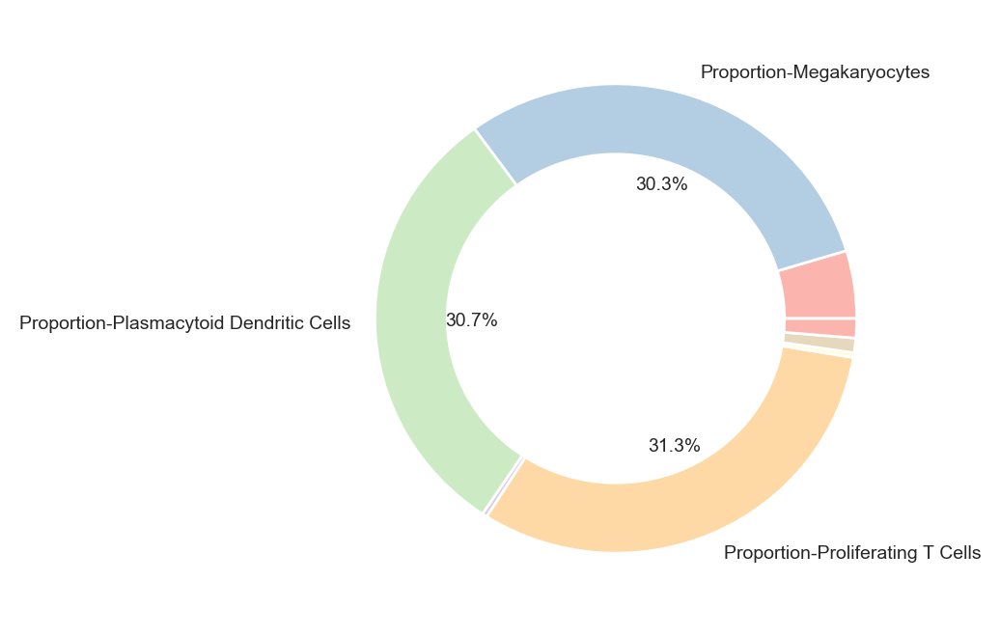

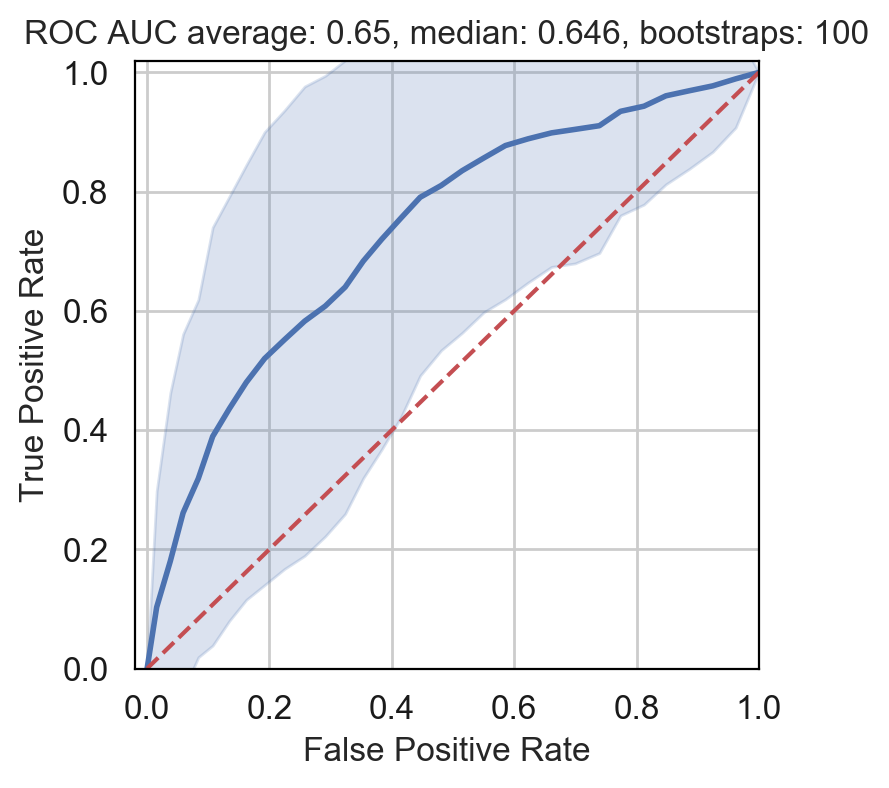

In [965]:
show_VOI(VOIs)
plot_ROC(ROC_AUC, FPR, TPR)

# Ordering of cells based on Total and CM Specific Signatures

In [360]:
fdata = adata[adata.obs['ct_cov']=='Classical Monocytes']
fdata.obs['CM_Specific'] = np.ravel(fdata.raw.X[:, fdata.raw.var_names.isin(URG_exclude['Classical Monocytes'])].mean(axis=1))/np.max(np.ravel(fdata.raw.X[:, fdata.raw.var_names.isin(URG_exclude['Classical Monocytes'])].mean(axis=1)))
fdata.obs['Total-PBMC-Sig'] = np.ravel(fdata.raw.X[:, fdata.raw.var_names.isin(URG_total)].mean(axis=1))/np.max(np.ravel(fdata.raw.X[:, fdata.raw.var_names.isin(URG_total)].mean(axis=1)))

Trying to set attribute `.obs` of view, copying.


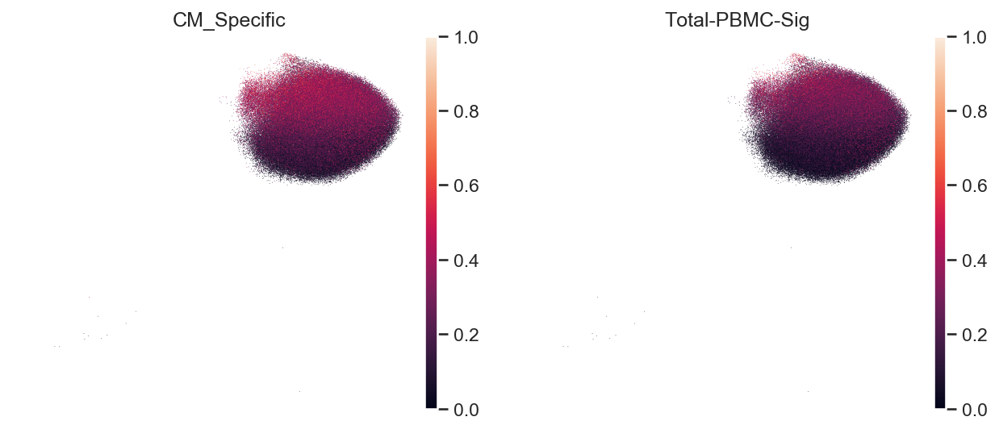

In [361]:
sc.pl.umap(fdata, color=['CM_Specific', 'Total-PBMC-Sig'])

In [406]:
vals_H, rng = np.histogram(fdata.obs['Total-PBMC-Sig'][fdata.obs['SLE status']=='Healthy'].values, bins=20, range=(0, 1))
vals_HT = vals_H/np.max(vals_H)
vals_SLE, rng =np.histogram(fdata.obs['Total-PBMC-Sig'][fdata.obs['SLE status']=='SLE'].values, bins=20, range=(0, 1))
vals_SLET = vals_SLE/np.max(vals_SLE)
vals_H, rng = np.histogram(fdata.obs['CM_Specific'][fdata.obs['SLE status']=='Healthy'].values, bins=20, range=(0, 1))
vals_HC = vals_H/np.max(vals_H)
vals_SLE, rng =np.histogram(fdata.obs['CM_Specific'][fdata.obs['SLE status']=='SLE'].values, bins=20, range=(0, 1))
vals_SLEC = vals_SLE/np.max(vals_SLE)

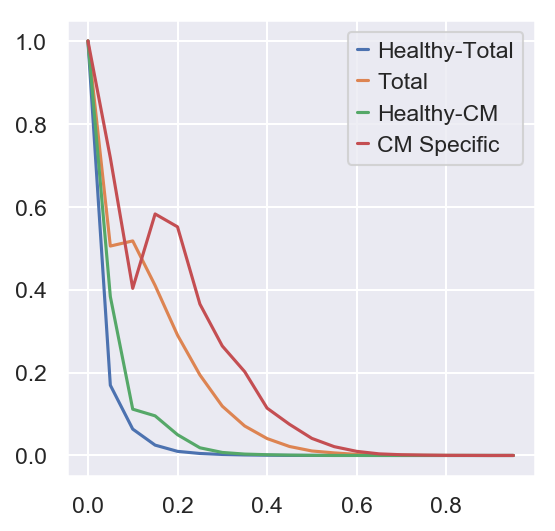

In [408]:
sns.lineplot(rng[:-1], vals_HT, label='Healthy-Total')
sns.lineplot(rng[:-1], vals_SLET, label='Total')
sns.lineplot(rng[:-1], vals_HC, label='Healthy-CM')
sns.lineplot(rng[:-1], vals_SLEC, label='CM Specific')
plt.legend()